# Objectif 

L'objectif de jupyter notebook est de débuter l'étude des données réelles. Les données AIS sont traitées afin d'identifier deux trajectoires de navires propices au processus de localisation par MFP sur répliques mesurées. 

## Données AIS 
Les données AIS sont celles du fichier extract-ais-pos-for-zone-ecole-navale-by-month-201305.csv. Ce fichier contient les données AIS prétraitrées pour la zone RHUMRUM et pour le mois de mai 2013. Les données sont filtrées pour ne garder que les navires circulant dans une boxe de 1° x 1° centrée sur la sous antenne SWIR. 

Ce premier traitement permet d'identifier 2 trajectoires d'intérêt. Les coordonnées sont projetées dans un repère cartésien local (ENU) centré sur le barycentre des deux trajectoires et l'intersection des deux trajectoires est calculée en résolvant le système d'équations relatif à chaque pair de segments des deux trajectoires considérées. 

## Données audio 
Les données audios sont chargées au format .wav depuis la base de données RESIF. Une plage de 4h est chargée autour de chaque instant d'intersection des deux trajectoires. 

In [1]:
#!/usr/bin/env python
# -*-coding:utf-8 -*-
'''
@File    :   real_data_analysis_1.ipynb
@Time    :   2024/09/06 12:01:19
@Author  :   Menetrier Baptiste 
@Version :   1.0
@Contact :   baptiste.menetrier@ecole-navale.fr
@Desc    :   None
'''

# ======================================================================================================================
# Import
# ======================================================================================================================
# %matplotlib ipympl

import sys 
sys.path.append(r"C:\Users\baptiste.menetrier\Desktop\devPy\phd")

import os 
import pandas as pd
import numpy as np
import scipy.fft as sf
import scipy.signal as sp
import matplotlib.pyplot as plt

from get_data.ais.ais_tools import *
from real_data_analysis.signal_processing_utils import *
from publication.PublicationFigure import PubFigure
from localisation.verlinden.misc.verlinden_utils import load_rhumrum_obs_pos

## AIS data

In [2]:
# Usefulls params 

root = r"C:\Users\baptiste.menetrier\Desktop\devPy\phd\data\ais\extract-ais-pos-for-zone-ecole-navale-by-month-201305.csv"
fname = "extract-ais-pos-for-zone-ecole-navale-by-month-201305.csv"
fpath = os.path.join(root, fname)

lon_min = 65
lon_max = 66
lat_min = -28
lat_max = -27

### Load and pre-process AIS data

In [3]:
# Load and pre-filter
df = extract_ais_area(fpath, lon_min, lon_max, lat_min, lat_max)
# Remove ships with less than 2 points
df = df.groupby("mmsi").filter(lambda x: len(x) > 1)
# Interpolate trajectories to have a point every 5 minutes 
df_interp = interpolate_trajectories(df, time_step="5min")
print(df_interp.head())

                 time        lon        lat       mmsi   shipName
0 2013-05-10 15:26:00  65.968008 -27.012057  574693000  VOSCO SKY
1 2013-05-10 15:29:39  65.948845 -27.020171  574693000  VOSCO SKY
2 2013-05-10 15:34:39  65.935739 -27.025775  574693000  VOSCO SKY
3 2013-05-10 15:39:39  65.922631 -27.031379  574693000  VOSCO SKY
4 2013-05-10 15:44:39  65.909522 -27.036981  574693000  VOSCO SKY


### Plot all trajectories 

Remarque sur les stations OBS : 
- La station RR45 n'enregistre pas au mois de mai 2013 (période des données AIS)
- La station RR42 échantillonne à 50 Hz 
- La station RR46 n'enregistre que jusqu'au 26/05/2013

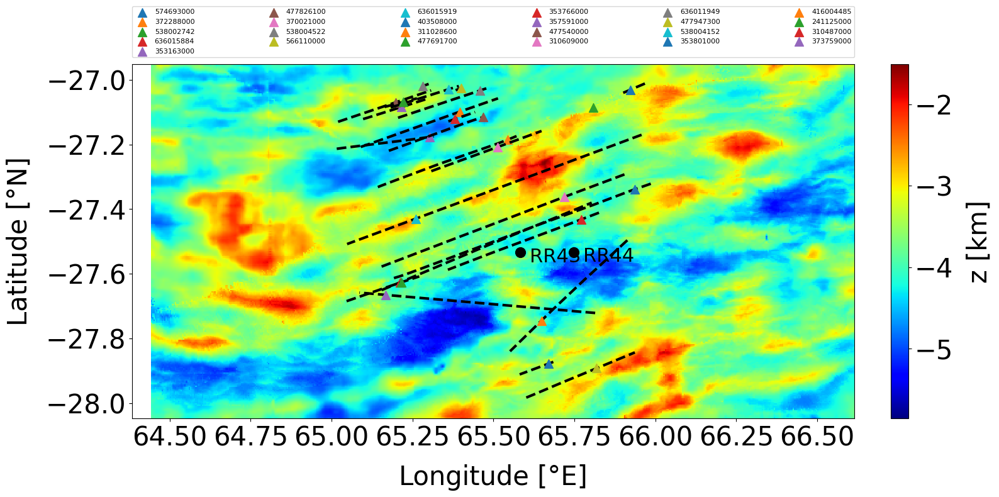

In [4]:
# Plot all trajectories
plt.figure()

# rcv_id = ["RR41", "RR44", "RR45", "RR47"] "RR46"
# Select stations to analyse

# station_id = ["RR41", "RR43", "RR44", "RR47", "RR48"]
# station_id = ["RR41", "RR43", "RR48"]
station_id = ["RR43", "RR44"]

rcv_info = {"id": station_id, "lons": [], "lats": []}
for obs_id in rcv_info["id"]:
    pos_obs = load_rhumrum_obs_pos(obs_id)
    rcv_info["lons"].append(pos_obs.lon)
    rcv_info["lats"].append(pos_obs.lat)


plot_traj_over_bathy(df_interp, rcv_info, lon_min, lon_max, lat_min, lat_max)


### Plot selected trajectories 

In [5]:
# Selected ships
mmsi1 = 403508000
mmsi2 = 353766000
# NAVIOS / SHUI HO
# mmsi1 = 416004485 
# mmsi2 = 373759000
mmsi_selected = [mmsi1, mmsi2]

In [6]:
# Select given ships
df_select = df_interp[df_interp["mmsi"].isin(mmsi_selected)]
# Reset index 
df_select.reset_index(drop=True, inplace=True)

# Convert to ENU
project_to_enu(df=df_select)

# Compute intersection
intersection_wgs84, intersection_time_s1, intersection_time_s2 = (
    intersection_time_2ships(df_2ships=df_select)
)
print("Intersection time ship 1: ", intersection_time_s1)
print("Intersection time ship 2: ", intersection_time_s2)
print("Intersection position: ", intersection_wgs84)

Intersection time ship 1:  [Timestamp('2013-05-28 04:37:26.270309495')]
Intersection time ship 2:  [Timestamp('2013-05-07 10:00:44.750288243')]
Intersection position:  [(65.6248757731448, -27.453620128992046)]


In [7]:
# Store intersection time in a dictionary for simplicity
intersection_time = {mmsi1: intersection_time_s1[0], mmsi2: intersection_time_s2[0]}
print(intersection_time)

{403508000: Timestamp('2013-05-28 04:37:26.270309495'), 353766000: Timestamp('2013-05-07 10:00:44.750288243')}


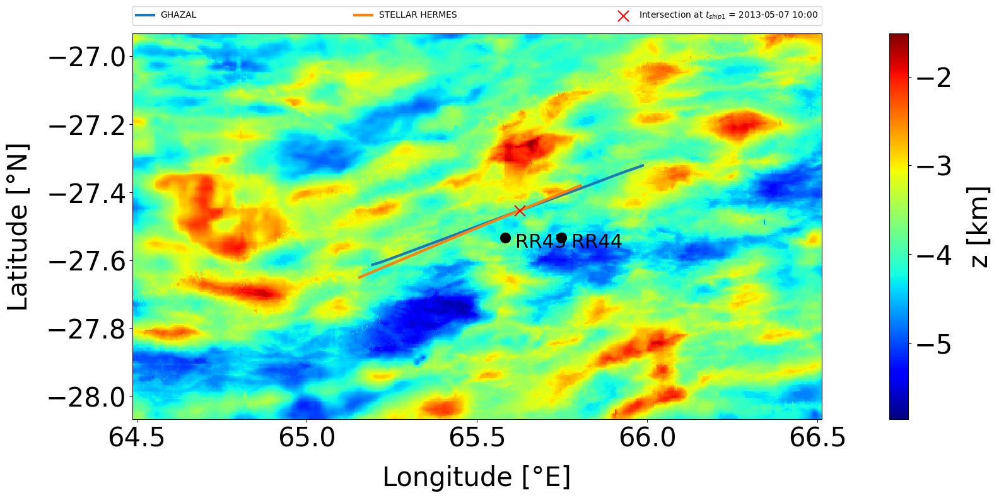

In [8]:
# Plot selected ships
intersection_data = {"intersection_wgs84": intersection_wgs84, "intersection_time": intersection_time, "intersection_time_s1": intersection_time_s1, "intersection_time_s2": intersection_time_s2}
plot_traj_over_bathy(df_select, rcv_info, lon_min, lon_max, lat_min, lat_max, intersection_data=intersection_data)


In [9]:
# Total routes duration
ship_names = df_select["shipName"].unique()
for ship_name in ship_names:
    df_select_tmp = df_select[df_select["shipName"] == ship_name]
    print(f"{ship_name} -> routes from {df_select_tmp['time'].min()} to {df_select_tmp['time'].max()}")

# print(f"{} -> routes from {df_select['time'].min()} to {df_select['time'].max()}")

GHAZAL -> routes from 2013-05-28 02:48:37 to 2013-05-28 06:26:33
STELLAR HERMES -> routes from 2013-05-07 07:23:35 to 2013-05-07 11:02:26


## WAV data 

In [10]:
# Define the time window according to the ais data available
ais_data_duration = {}
for mmsi in mmsi_selected:
    df_select_tmp = df_select[df_select["mmsi"] == mmsi]
    t_start = df_select_tmp["time"].min()
    t_end = df_select_tmp["time"].max()

    t_intersec_to_start = intersection_time[mmsi] - t_start
    t_end_to_intersec = t_end - intersection_time[mmsi]
    ais_data_duration[mmsi] = max(t_intersec_to_start, t_end_to_intersec)
    print(f"Duration of the ais data {mmsi}: {ais_data_duration[mmsi]}")

# Define time window half length
min_duration = min(ais_data_duration.values())
# Convert min_duration to minutes
min_duration_minutes = np.floor(min_duration.total_seconds() / 60)
# Define half window duration
t_half_window = pd.Timedelta(f"{min_duration_minutes//2}min")
print(f"Half window duration: {t_half_window}")

t_start_1 = intersection_time[mmsi1] - t_half_window
t_start_2 = intersection_time[mmsi2] - t_half_window
t_end_1 = intersection_time[mmsi1] + t_half_window
t_end_2 = intersection_time[mmsi2] + t_half_window
duration_seconds = 2 * t_half_window.total_seconds()

start_times = [t_start_1, t_start_2]

print(f"Time window for ship 1: {t_start_1} -> {t_end_1}")
print(f"Time window for ship 2: {t_start_2} -> {t_end_2}")

print(f"Duration of the time window: {duration_seconds / 3600} hours")

Duration of the ais data 403508000: 0 days 01:49:06.729690505
Duration of the ais data 353766000: 0 days 02:37:09.750288243
Half window duration: 0 days 00:54:00
Time window for ship 1: 2013-05-28 03:43:26.270309495 -> 2013-05-28 05:31:26.270309495
Time window for ship 2: 2013-05-07 09:06:44.750288243 -> 2013-05-07 10:54:44.750288243
Duration of the time window: 1.8 hours


In [11]:
# Restrict ais data to the time window
df_select_1 = df_select[df_select["mmsi"] == mmsi1]
df_select_2 = df_select[df_select["mmsi"] == mmsi2]

df_select_restricted = pd.concat(
    [   
        df_select_1[
            (df_select_1["time"] >= t_start_1) & (df_select_1["time"] <= t_end_1)
        ],
        df_select_2[
            (df_select_2["time"] >= t_start_2) & (df_select_2["time"] <= t_end_2)
        ],
    ]
)

df_select = df_select_restricted
df_select.reset_index(drop=True, inplace=True)
print(df_select.head())

                 time        lon        lat       mmsi shipName         x_enu  \
0 2013-05-28 03:45:17  65.415801 -27.531884  403508000   GHAZAL -13170.389849   
1 2013-05-28 03:50:17  65.434855 -27.524759  403508000   GHAZAL -11288.905585   
2 2013-05-28 03:55:17  65.453906 -27.517631  403508000   GHAZAL  -9407.421321   
3 2013-05-28 04:00:17  65.472955 -27.510501  403508000   GHAZAL  -7525.937057   
4 2013-05-28 04:05:17  65.492001 -27.503368  403508000   GHAZAL  -5644.452793   

         y_enu  
0 -5539.903937  
1 -4748.489089  
2 -3957.074241  
3 -3165.659393  
4 -2374.244544  


### Load data and compute usefull quantities 

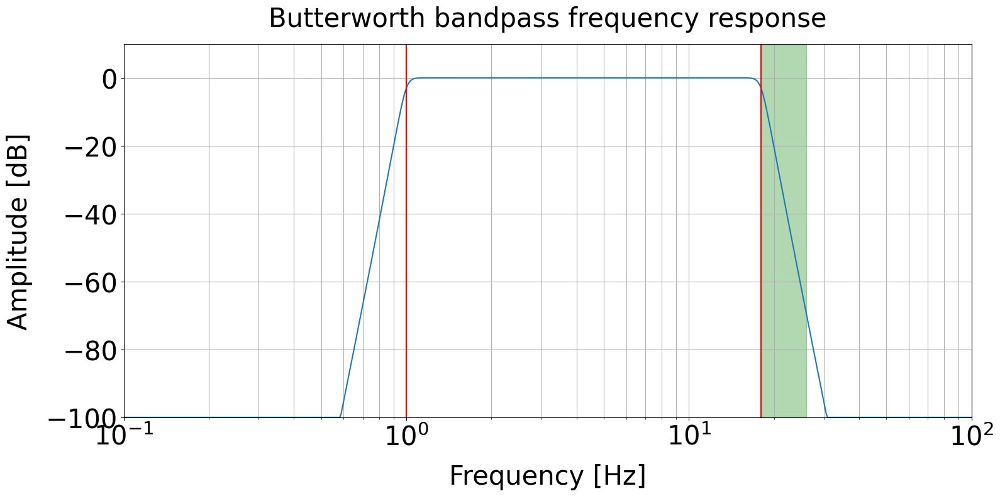

In [12]:
# Design filter to remove chorus
fs = 50
fmin = 1
fmax = 18
corners = 20
btype = "bandpass"

b, a = sp.iirfilter(
    N=corners,
    Wn=[fmin * 2 * np.pi, fmax * 2 * np.pi],
    # Wn=fmax * 2 * np.pi,
    btype=btype,
    ftype="butter",
    analog=True,
)
w, h = sp.freqs(b, a, 1000)

# print(f"Filter designed with a {btype} type and a {corners}-order")
# print(f"Freqs {w / (2 * np.pi)}")
# print(f"Filter frequency response: {20 * np.log10(np.maximum(abs(h), 1e-5))}")
# print(a, b)

fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)
ax.semilogx(w / (2*np.pi), 20 * np.log10(np.maximum(abs(h), 1e-5)))
ax.set_title("Butterworth bandpass frequency response")
ax.set_xlabel("Frequency [Hz]")
ax.set_ylabel("Amplitude [dB]")


# Add vertical line at fmin and fmax
ax.axvline(fmin, color="r")
ax.axvline(fmax, color="r")

# Add chorus frequency range
chorus_freq = [18, 26]
ax.axvspan(chorus_freq[0], chorus_freq[1], color="g", alpha=0.3)

ax.axis((0.1, 100, -100, 10))
ax.grid(which="both", axis="both")

In [13]:
# We are only interested in the hydrophone channel
ch = ["BDH"]

# Select frequency properties
fmin = 4
fmax = 18
filter_type = "bandpass"
filter_corners = 20

loaded_data = load_data(station_id, mmsi_selected, start_times, ch=ch, fmin=fmin, fmax=fmax, filter_type=filter_type, filter_corners=filter_corners, duration_seconds=duration_seconds)

IndexError: list index out of range

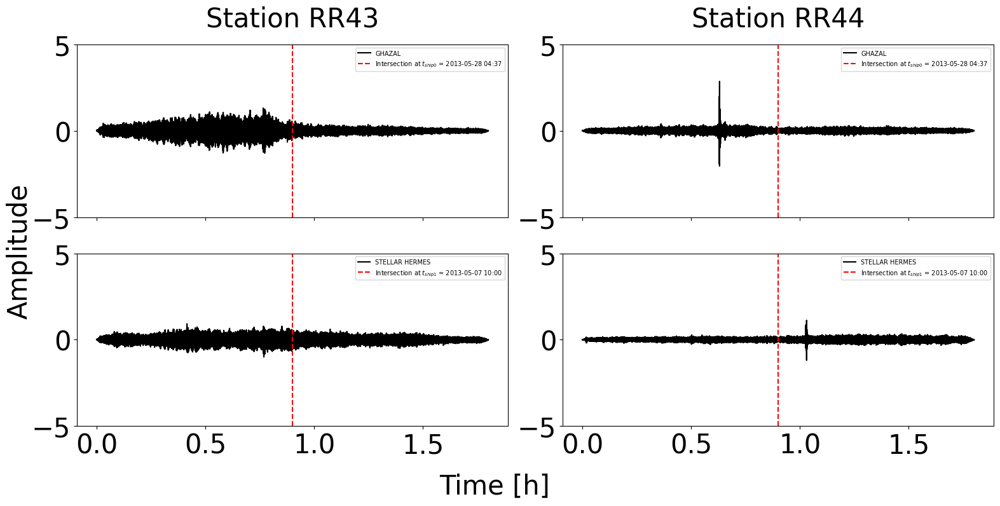

In [ ]:
# Plot times series
n_stations = len(station_id)
n_ships = len(mmsi_selected)

plot_time_series(wav_data=loaded_data, ais_data=df_select, intersection_time=intersection_time)

(<Figure size 1600x800 with 4 Axes>,
 array([[<Axes: title={'center': 'Station RR43'}>,
         <Axes: title={'center': 'Station RR44'}>],
        [<Axes: >, <Axes: >]], dtype=object))

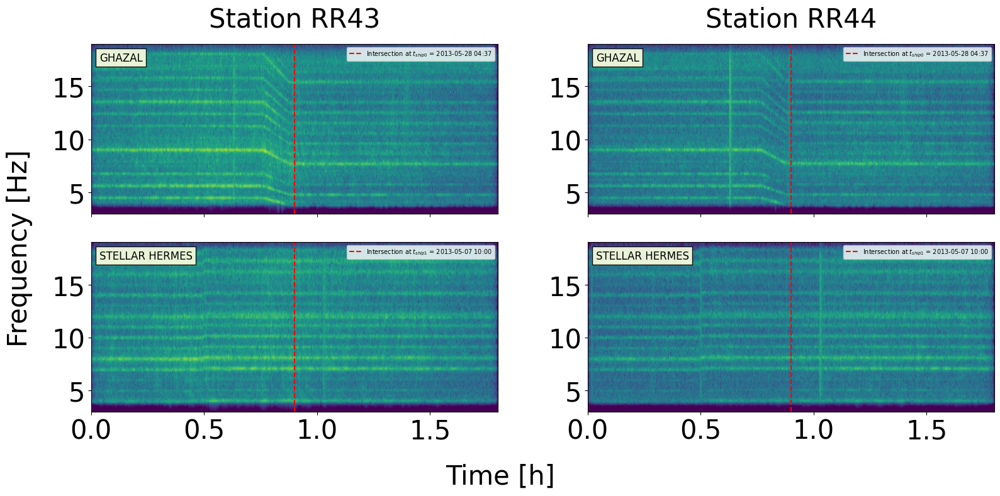

In [ ]:
# Plot spectrograms
plot_spectrograms(
    wav_data=loaded_data, ais_data=df_select, intersection_time=intersection_time, fmin=fmin, fmax=fmax)

## Distance ship to receiver

In [ ]:
# Compute distance
distance = compute_distance_ship_rcv(df_select, rcv_info)
# print(distance)
# print(df_select.head())

In [ ]:
# Derive CPA for each each ship and each receiver
cpa = get_cpa(ais_data=df_select, distance=distance, rcv_info=rcv_info)
print(cpa)

{403508000: {'RR43': {'lon': 65.54912629898026, 'lat': -27.481953933220275, 'time': Timestamp('2013-05-28 04:20:17'), 'r_cpa': 6629.131660078118}, 'RR44': {'lon': 65.69957805313925, 'lat': -27.426414316779777, 'time': Timestamp('2013-05-28 04:59:12'), 'r_cpa': 12685.702304763592}}, 353766000: {'RR43': {'lon': 65.55721570790705, 'lat': -27.48132771392162, 'time': Timestamp('2013-05-07 09:37:26'), 'r_cpa': 6332.409796782396}, 'RR44': {'lon': 65.68778918459014, 'lat': -27.42781432436585, 'time': Timestamp('2013-05-07 10:22:26'), 'r_cpa': 13032.211290831396}}}


### Plot distances

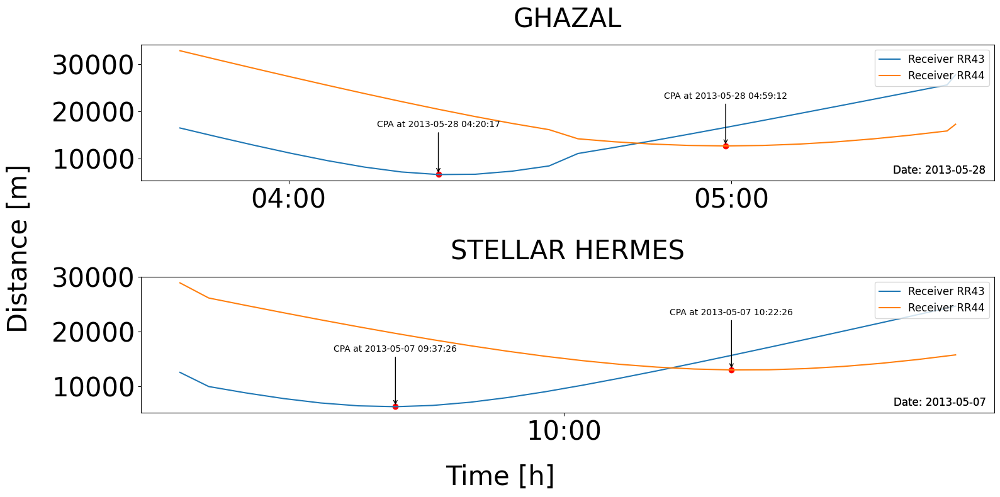

In [ ]:
plot_distance_ship_rcv(ais_data=df_select, distance=distance, cpa=cpa, rcv_info=rcv_info)

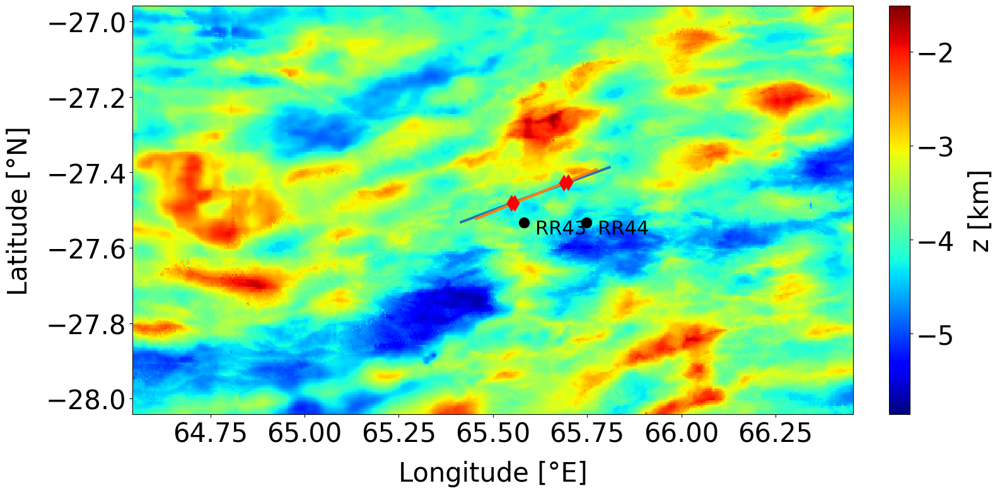

In [ ]:
# Plot the CPA on the map
plt.figure()

ds_bathy = plot_swir_bathy(contour=False)
plot_swir_obs(ds_bathy, rcv_info["id"], col=None)
PubFigure(legend_fontsize=20)

for mmsi in df_select["mmsi"].unique():
    df_tmp = df_select[df_select["mmsi"] == mmsi]
    plt.plot(
        df_tmp["lon"],
        df_tmp["lat"],
        "-",
        label=df_tmp["shipName"].values[0],
        linewidth=3,
    )
plt.ylim(lat_min, lat_max)
plt.xlim(lon_min, lon_max)


# Add CPA
for mmsi in df_select["mmsi"].unique():
    for rcv_id in rcv_info["id"]:
        lon = cpa[mmsi][rcv_id]["lon"]
        lat = cpa[mmsi][rcv_id]["lat"]
        plt.scatter(lon, lat, s=150, marker="d", color="r", zorder=2)

### Derive time delay 

In [ ]:
# Derive propagation time from each ship position to each receiver asssuming constant speed of sound
c0 = 1500   # Speed of sound in water in m/s
propagation_time = {}

for mmsi in df_select["mmsi"].unique():
    propagation_time[mmsi] = {}
    for rcv_id in rcv_info["id"]:
        propagation_time[mmsi][rcv_id] = distance[mmsi][rcv_id] / c0

# print(propagation_time)

Text(0.02, 0.5, 'TOF [s]')

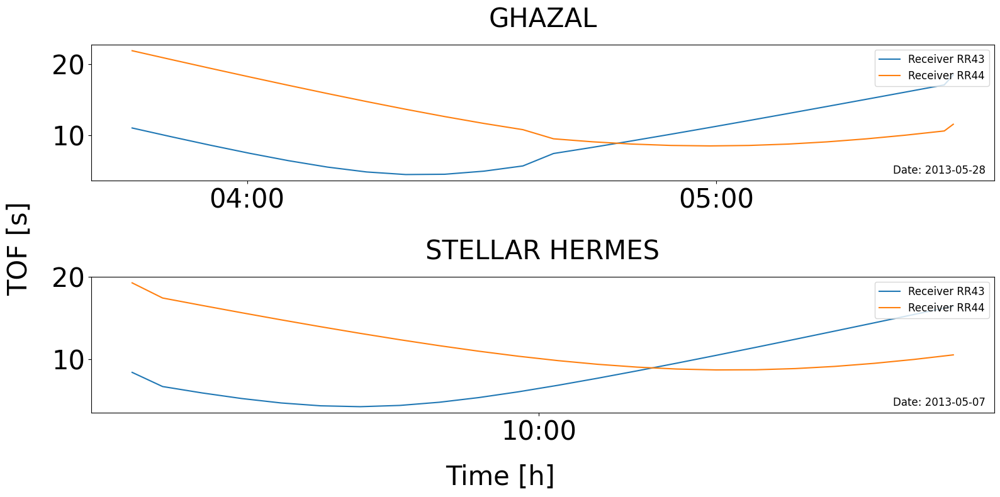

In [ ]:
# Plot propagation time from ship to receiver as a function of time
fig, ax = plt.subplots(n_ships, 1, sharex=False)
for j, mmsi in enumerate(mmsi_selected):
    df_mmsi = df_select[df_select["mmsi"] == mmsi]
    for rcv_id in rcv_info["id"]:
        ax[j].plot(
            df_mmsi["time"], propagation_time[mmsi][rcv_id], label=f"Receiver {rcv_id}"
        )

    ship_name = df_mmsi["shipName"].values[0]
    ax[j].set_title(f"{ship_name}")
    # ax[j].set_ylabel("TOF [s]")
    ax[j].legend(loc="upper right", fontsize=12)
    # ax[j].set_xlabel("Time [s]")

    ax[j].xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))
    ax[j].xaxis.set_major_locator(mdates.HourLocator(interval=1))

    # Get the last date in the time data
    end_date = df_mmsi["time"].iloc[0].strftime("%Y-%m-%d")

    # Add the date as text at the end of the x-axis
    ax[j].text(0.99, 0.05, f"Date: {end_date}", transform=ax[j].transAxes, ha="right", fontsize=12)
    ax[j].tick_params(axis="x", rotation=0)

fig.supxlabel("Time [h]")
fig.supylabel("TOF [s]")

In [ ]:
# Derive time delay between receiver couples for each ship position 
time_delay = {}
for mmsi in df_select["mmsi"].unique():
    time_delay[mmsi] = {}
    for i, rcv_id1 in enumerate(rcv_info["id"]):
        for j, rcv_id2 in enumerate(rcv_info["id"]):
            # Rcvi - Rcvj is equivalent to Rcvj - Rcvi, only one couple needs to be evaluated
            if i < j:
                time_delay[mmsi][f"{rcv_id1}_{rcv_id2}"] = (
                    propagation_time[mmsi][rcv_id1] - propagation_time[mmsi][rcv_id2]
                )

# print(time_delay)

Text(0.02, 0.5, '$\\tau [s]$')

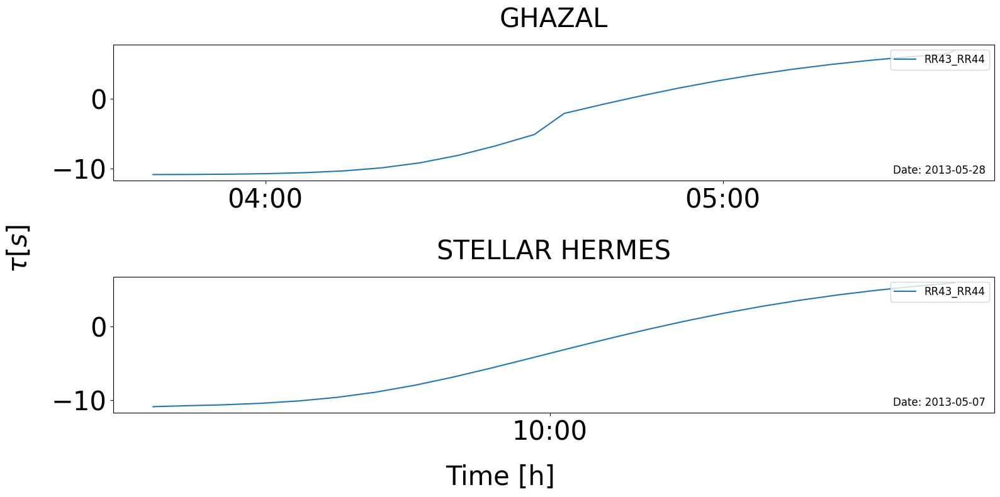

In [ ]:
# Plot time delay between receiver couples as a function of time for each ship 
fig, ax = plt.subplots(n_ships, 1, sharex=False)
for j, mmsi in enumerate(mmsi_selected):
    df_mmsi = df_select[df_select["mmsi"] == mmsi]
    for delay_key in time_delay[mmsi].keys():
        ax[j].plot(
            df_mmsi["time"], time_delay[mmsi][delay_key], label=f"{delay_key}"
        )

    ship_name = df_mmsi["shipName"].values[0]
    ax[j].set_title(f"{ship_name}")
    # ax[j].set_ylabel(r"$\tau [s]$")
    ax[j].legend(loc="upper right", fontsize=12)
    # ax[j].set_xlabel("Time [s]")

    ax[j].xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))
    ax[j].xaxis.set_major_locator(mdates.HourLocator(interval=1))

    # Get the last date in the time data
    end_date = df_mmsi["time"].iloc[0].strftime("%Y-%m-%d")

    # Add the date as text at the end of the x-axis
    ax[j].text(0.99, 0.05, f"Date: {end_date}", transform=ax[j].transAxes, ha="right", fontsize=12)
    ax[j].tick_params(axis="x", rotation=0)

fig.supxlabel("Time [h]")
fig.supylabel(r"$\tau [s]$")

### Derive correlation window duration

Correlation window must be sufficiently large to include signal from both ship
A sufficient condition is given by $T_{corr} \geq \tau + \max{T_{r1}, T_{r2}}$ where $\tau$ is the delay between R1 and R2 and $T_{r1}$ and $T_{r2}$ represents the
impulse response duration corresponding to waveguides between the ship position and the receivers

In [ ]:
# Derive maximum time delay for each ship
Tau = {}
for j, mmsi in enumerate(mmsi_selected):
    Tau[mmsi] = {}
    for delay_key in time_delay[mmsi].keys():
        Tau[mmsi][delay_key] = np.max(np.abs(time_delay[mmsi][delay_key]))

# print(Tau[mmsi].values())

#### First approach 

In [ ]:
# First approach : lets try some values for Tri
impulse_response_max_duration = 20
delta_t_stat = 20 * 60
# delta_t_stat = 80

Tcorr = {}
for j, mmsi in enumerate(mmsi_selected):
    tau = np.max(np.fromiter(Tau[mmsi].values(), dtype=float))
    Tcorr[mmsi] = tau + impulse_response_max_duration + delta_t_stat

print(Tcorr)

{403508000: 1230.898288991777, 353766000: 1230.8740787816994}


#### Second approach : use impulse response derived from kraken simulations (TODO)

In [ ]:
# TODO
# print()

### Derive correlation using appropriate window size 

In [ ]:
# Compute the cross-correlation between the signals received by the two receivers for each ship
# First : derive STFT using appropriate window length derived before

stft_data_crosscorr = {}
for mmsi in mmsi_selected:
    stft_data_crosscorr[mmsi] = {}
    for i, s_id in enumerate(station_id):
        data = loaded_data[s_id][mmsi]
        fs = data["sig"].meta.sampling_rate
        nperseg = np.floor(Tcorr[mmsi] * fs).astype(int)    # Window length
        noverlap = int(nperseg * 1/2)                         # Overlap length
        # print(f"Window length: {nperseg}")
        # print(f"Window duration: {nperseg / fs}s")

        # Derive stft
        f, tt, stft = sp.stft(
            data["data"],
            fs=fs,
            window="hann",
            nperseg=nperseg,
            noverlap=noverlap,
        )
        stft_data_crosscorr[mmsi][s_id] = {}
        stft_data_crosscorr[mmsi][s_id]["f"] = f
        stft_data_crosscorr[mmsi][s_id]["tt"] = tt
        stft_data_crosscorr[mmsi][s_id]["stft"] = stft

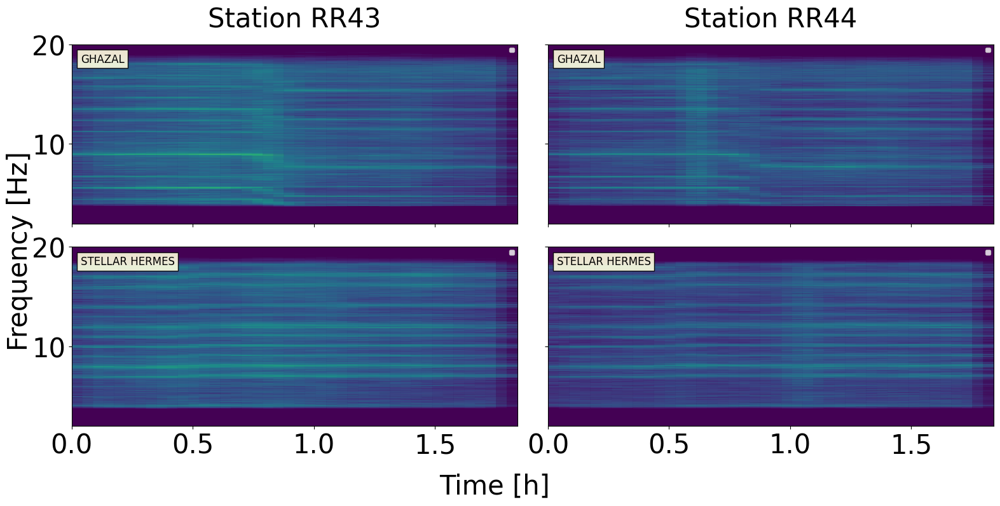

In [ ]:
# Plot spectrograms
vmin = -100
vmax = 0

n_ships = len(mmsi_selected)
n_stations = len(station_id)
fig, ax = plt.subplots(n_ships, n_stations, sharex=True, sharey=True)

# Reshape ax if only one station
if n_stations == 1:
    ax = np.array([ax])
if n_ships == 1:
    ax = np.array([ax])

for i, s_id in enumerate(station_id):
    for j, mmsi in enumerate(mmsi_selected):
        stft = stft_data_crosscorr[mmsi][s_id]["stft"]
        f = stft_data_crosscorr[mmsi][s_id]["f"]
        tt = stft_data_crosscorr[mmsi][s_id]["tt"]

        ship_name = df_select[df_select["mmsi"] == mmsi]["shipName"].values[0]

        tt_hour = tt / 3600
        ax[j, i].pcolormesh(
            tt_hour,
            f,
            20 * np.log10(np.abs(stft)),
            shading="gouraud",
            vmin=vmin,
            vmax=vmax,
        )

        # ax[j, 0].set_ylabel("Frequency [Hz]")
        ax[j, i].text(
            0.02,
            0.9,
            ship_name,
            transform=ax[j, i].transAxes,
            ha="left",
            fontsize=12,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )
        ax[j, i].legend(loc="upper right", fontsize=7)

    ax[0, i].set_title(f"Station {station_id[i]}")
    # ax[-1, i].set_xlabel("Time [h]")

fig.supxlabel("Time [h]")
fig.supylabel("Frequency [Hz]")
plt.ylim([fmin - 2, fmax + 2])
plt.tight_layout()

In [ ]:
print(tt.shape)
print(f.shape)
print(stft.shape)

(22,)
(31544,)
(31544, 22)


In [ ]:
# Second : compute the cross-correlation between the two signals for each ship and each time window
s_xy = {}
coh_xy = {}
crosscorr_data = {}
for mmsi in mmsi_selected:
    s_xy[mmsi] = {}
    coh_xy[mmsi] = {}
    crosscorr_data[mmsi] = {}

    for i, rcv_id1 in enumerate(rcv_info["id"]):
        for j, rcv_id2 in enumerate(rcv_info["id"]):
            # Intercorr for Rcvi / Rcvj is equivalent to Rcvj / Rcvi, only one couple needs to be evaluated
            if i < j:
                rcv_couple_id = f"{rcv_id1}_{rcv_id2}"
                stft_1 = stft_data_crosscorr[mmsi][rcv_id1]["stft"]
                stft_2 = stft_data_crosscorr[mmsi][rcv_id2]["stft"]
                f = stft_data_crosscorr[mmsi][rcv_id1]["f"]
                tt = stft_data_crosscorr[mmsi][rcv_id1]["tt"]

                # Compute cross spectrum
                s_12 = stft_1 * np.conj(stft_2)
                s_11 = stft_1 * np.conj(stft_1)
                s_22 = stft_2 * np.conj(stft_2)

                # Store cross spectrum
                s_xy[mmsi][rcv_couple_id] = {}
                s_xy[mmsi][rcv_couple_id]["f"] = f
                s_xy[mmsi][rcv_couple_id]["tt"] = tt
                s_xy[mmsi][rcv_couple_id]["s_xy"] = s_12

                # Derive coherence
                coh_12= np.abs(s_12)**2 / (np.abs(s_11) * np.abs(s_22))
                coh_xy[mmsi][rcv_couple_id] = {}
                coh_xy[mmsi][rcv_couple_id]["f"] = f
                coh_xy[mmsi][rcv_couple_id]["tt"] = tt 
                coh_xy[mmsi][rcv_couple_id]["coh_xy"] = coh_12

                # Compute cross-correlation
                # Derive correlation lags
                lags = sp.correlation_lags(
                    len(np.fft.irfft(stft_1[:, 0])),
                    len(np.fft.irfft(stft_2[:, 0])),
                    mode="full",
                )

                c_xy = np.zeros((stft_1.shape[1], len(lags)), dtype=float)
                for k in range(len(tt)):
                    x = np.fft.irfft(stft_1[:, k])
                    y = np.fft.irfft(stft_2[:, k])
                    c_xy_k = sp.correlate(x, y, mode="full")
                    c_xy[k, :] = c_xy_k / np.max(np.abs(c_xy_k))

                # crosscorr = np.fft.irfft(s_12, axis=0)
                crosscorr_data[mmsi][rcv_couple_id] = {}
                crosscorr_data[mmsi][rcv_couple_id]["tt"] = tt
                crosscorr_data[mmsi][rcv_couple_id]["c_xy"] = c_xy 
                crosscorr_data[mmsi][rcv_couple_id]["lags"] = lags * 1/fs

In [ ]:
print(lags.shape)
print(tt.shape)
rcv_couple = f"{rcv_info['id'][0]}_{rcv_info['id'][1]}"
print(crosscorr_data[mmsi][rcv_couple]["c_xy"].shape)

n_couple = len(crosscorr_data[mmsi].keys())
print(n_couple)

(126171,)
(22,)
(22, 126171)
1


Text(0.02, 0.5, 'Time along trajectory [h]')

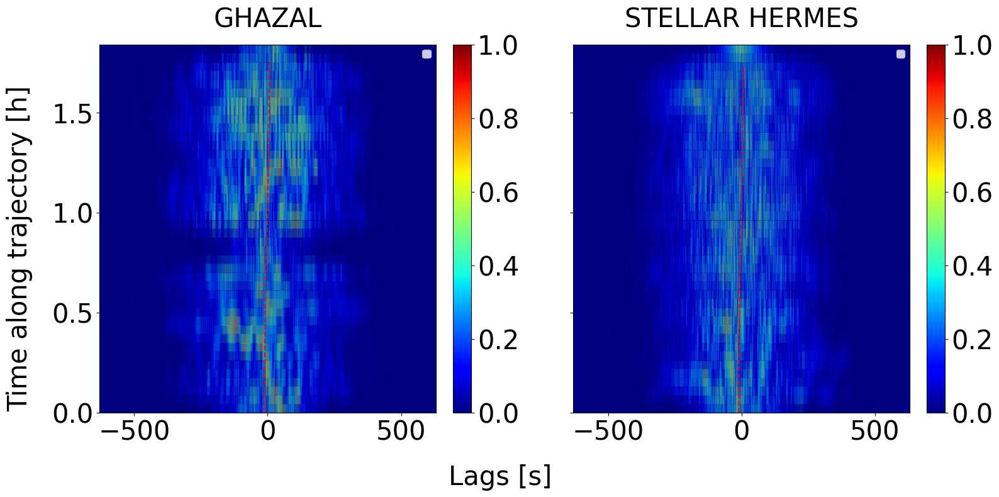

In [ ]:
# Third : plot the cross-correlation for each ship and each time window
fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# Reshape ax if only one couple
if n_couple == 1:
    ax = np.array([ax])

for j, mmsi in enumerate(mmsi_selected):

    df_mmsi = df_select[df_select["mmsi"] == mmsi]
    ship_name = df_mmsi["shipName"].values[0]
    ax[0, j].set_title(f"{ship_name}")

    for i, rcv_couple in enumerate(crosscorr_data[mmsi].keys()):

        crosscorr = crosscorr_data[mmsi][rcv_couple]["c_xy"]
        lags = crosscorr_data[mmsi][rcv_couple]["lags"]
        tt = crosscorr_data[mmsi][rcv_couple]["tt"]
        tt_hour = tt / 3600
        im = ax[i, j].pcolormesh(lags, tt_hour, np.abs(crosscorr), cmap="jet", shading="gouraud")

        ax[i, j].legend(loc="upper right", fontsize=12)

        # Add theoretical time delay
        tau_th = time_delay[mmsi][rcv_couple]
        time_along_traj = df_mmsi["time"].values

        # Convert time to seconds from the beginning of the trajectory
        time_along_traj = (time_along_traj - time_along_traj[0]).astype("timedelta64[s]").astype(float)

        # Convert time to hours
        time_along_traj = time_along_traj / 3600

        # Plot the theoretical time delay
        ax[i, j].plot(tau_th, time_along_traj, color="r", linestyle="--", label="Theoretical time delay", zorder=2)

        # Add colorbar 
        fig.colorbar(im, ax=ax[i, j])

fig.supxlabel("Lags [s]")
fig.supylabel("Time along trajectory [h]")


### Coherence spectrogram directly derived from STFT 

Text(0.02, 0.5, 'Frequency [Hz]')

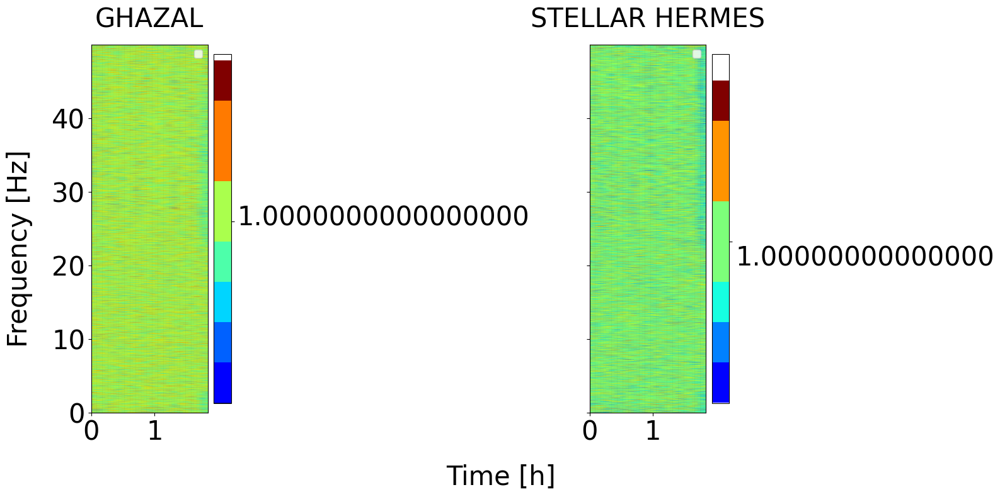

In [ ]:
# Plot coherence between receiver couples
fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# Reshape ax if only one couple
if n_couple == 1:
    ax = np.array([ax])

for j, mmsi in enumerate(mmsi_selected):
    df_mmsi = df_select[df_select["mmsi"] == mmsi]
    ship_name = df_mmsi["shipName"].values[0]
    ax[0, j].set_title(f"{ship_name}")

    for i, rcv_couple in enumerate(crosscorr_data[mmsi].keys()):
        coh = coh_xy[mmsi][rcv_couple]["coh_xy"]
        f = coh_xy[mmsi][rcv_couple]["f"]
        tt = coh_xy[mmsi][rcv_couple]["tt"]
        tt_hour = tt / 3600
        im = ax[i, j].pcolormesh(tt_hour, f, coh, cmap="jet", shading="gouraud")

        ax[i, j].legend(loc="upper right", fontsize=12)

        # Add colorbar 
        fig.colorbar(im, ax=ax[i, j])


fig.supxlabel("Time [h]")
fig.supylabel("Frequency [Hz]")

# Adjust space for colorbar and ensure it doesn't overlap with subplots
# fig.subplots_adjust(
#     right=0.85, hspace=0.4, wspace=0.4
# )  # Adjust right space for the colorbar

# # Add colorbar spanning all subplots, positioned to the right of the subplots
# cbar_ax = fig.add_axes(
#     [0.86, 0.15, 0.03, 0.7]
# )  # Adjust position to fit the colorbar outside
# fig.colorbar(im, cax=cbar_ax)

In [ ]:
# Derive coherence for the entire signal
coh, sxx, syy, sxy = compute_dsps(loaded_data, rcv_info)

Text(0.02, 0.5, 'Power [dB]')

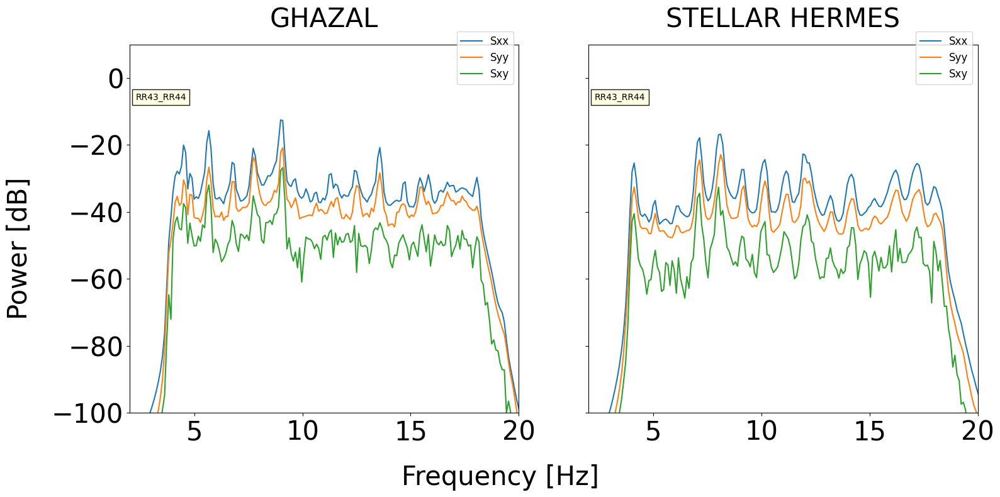

In [ ]:
# Plot DSPs
fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# Reshape ax if only one couple
if n_couple == 1:
    ax = np.array([ax])

for j, mmsi in enumerate(mmsi_selected):
    df_mmsi = df_select[df_select["mmsi"] == mmsi]
    ship_name = df_mmsi["shipName"].values[0]
    ax[0, j].set_title(f"{ship_name}")
    for i, rcv_couple in enumerate(sxx[mmsi].keys()):
        Sxx = sxx[mmsi][rcv_couple]["Sxx"]
        Syy = syy[mmsi][rcv_couple]["Syy"]
        Sxy = sxy[mmsi][rcv_couple]["Sxy"]
        f = sxx[mmsi][rcv_couple]["f"]
        im = ax[i, j].plot(f, 10 * np.log10(Sxx), label="Sxx")
        ax[i, j].plot(f, 10 * np.log10(Syy), label="Syy")
        ax[i, j].plot(f, 10 * np.log10(np.abs(Sxy)), label="Sxy")

        ax[i, j].set_xlim(fmin-2, fmax+2)
        ax[i, j].set_ylim(-100, 10)

        # Add text with the name of the receiver couple
        ax[i, j].text(
            0.015,
            0.85,
            rcv_couple,
            transform=ax[i, j].transAxes,
            ha="left",
            fontsize=10,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )

    ax[0, j].legend(fontsize=12, ncol=n_couple, bbox_to_anchor=(1, 1.05), loc="upper right")

fig.supxlabel("Frequency [Hz]")
fig.supylabel("Power [dB]")

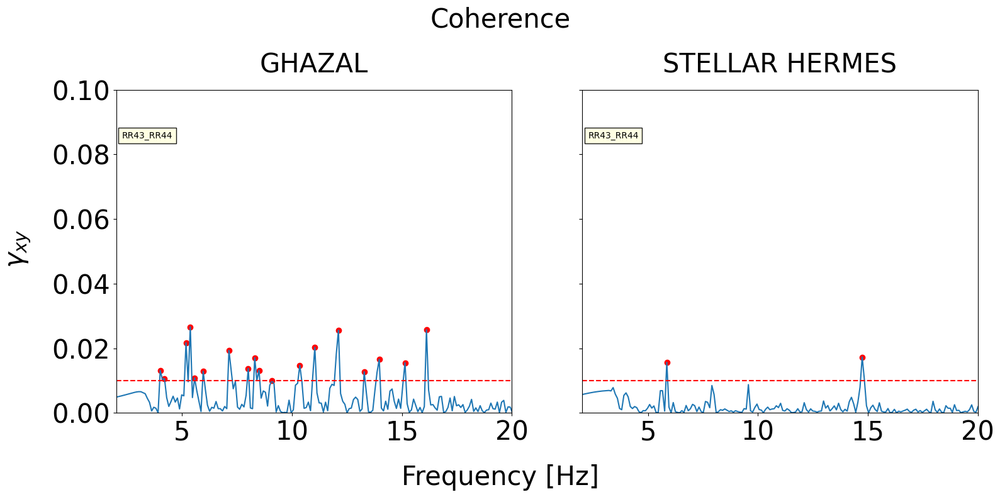

In [ ]:
# Plot coherence spectrum
fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# Reshape ax if only one couple
if n_couple == 1:
    ax = np.array([ax])

for j, mmsi in enumerate(mmsi_selected):
    df_mmsi = df_select[df_select["mmsi"] == mmsi]
    ship_name = df_mmsi["shipName"].values[0]
    ax[0, j].set_title(f"{ship_name}")
    for i, rcv_couple in enumerate(coh[mmsi].keys()):
        coh_xy = coh[mmsi][rcv_couple]["coh_xy"]
        f = coh[mmsi][rcv_couple]["f"]
        im = ax[i, j].plot(f, coh_xy, label=f"{rcv_couple}")
        # ax[i, j].plot(f, coh[mmsi][rcv_couple]["coh_xy_sp"], label=f"{rcv_couple} sp")

        # ax[i, j].set_xlabel("Frequency [Hz]")
        # ax[i, j].set_ylabel(r"$\gamma_{xy}$")
        # ax[i, j].legend(loc="upper right", fontsize=12)

        # Add text with the name of the receiver couple
        ax[i, j].text(
            0.015,
            0.85,
            rcv_couple,
            transform=ax[i, j].transAxes,
            ha="left",
            fontsize=10,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )

        ax[i, j].set_xlim(fmin-2, fmax+2)
        ax[i, j].set_ylim(0, 0.1)

fig.supxlabel("Frequency [Hz]")
fig.supylabel(r"$\gamma_{xy}$")
plt.suptitle("Coherence")

# Define a threshold on coherence to detect ship rays
coh_threshold = 0.01

# Plot threshold on coherence
for j, mmsi in enumerate(mmsi_selected):
    for i, rcv_couple in enumerate(coh[mmsi].keys()):
        ax[i, j].axhline(coh_threshold, color="r", linestyle="--", label="Threshold")

# Store frequencies where coherence is above threshold
f_detected = {}
for mmsi in mmsi_selected:
    f_detected[mmsi] = {}
    for i, rcv_couple in enumerate(coh[mmsi].keys()):
        # coh_above_th = coh[mmsi][rcv_couple]["coh_xy"] > coh_threshold

        # f_d = coh[mmsi][rcv_couple]["f"][coh[mmsi][rcv_couple]["coh_xy"] > coh_threshold]
        f_peaks = sp.find_peaks(coh[mmsi][rcv_couple]["coh_xy"], height=coh_threshold)[0]
        f_detected[mmsi][rcv_couple] = {}
        f_detected[mmsi][rcv_couple]["idx"] = f_peaks
        f_detected[mmsi][rcv_couple]["f"] = coh[mmsi][rcv_couple]["f"][f_peaks]

# Plot detected frequencies
for j, mmsi in enumerate(mmsi_selected):
    for i, rcv_couple in enumerate(coh[mmsi].keys()):
        ax[i, j].scatter(
            f_detected[mmsi][rcv_couple]["f"],
            coh[mmsi][rcv_couple]["coh_xy"][f_detected[mmsi][rcv_couple]["idx"]],
            color="r",
            label="Detected frequencies",
        )

Time corresponding to minimum tau for ship 403508000: 2013-05-28T04:49:12.000000000
Time corresponding to minimum tau for ship 353766000: 2013-05-07T10:12:26.000000000


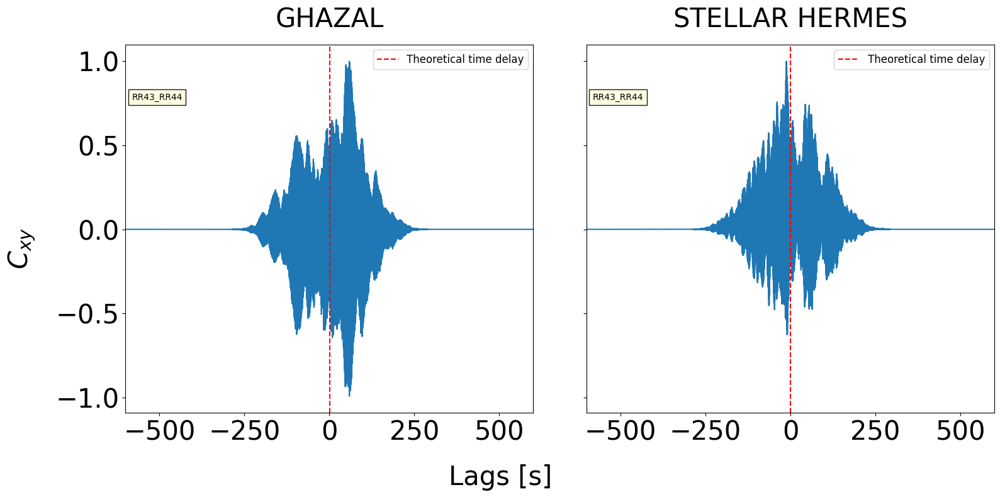

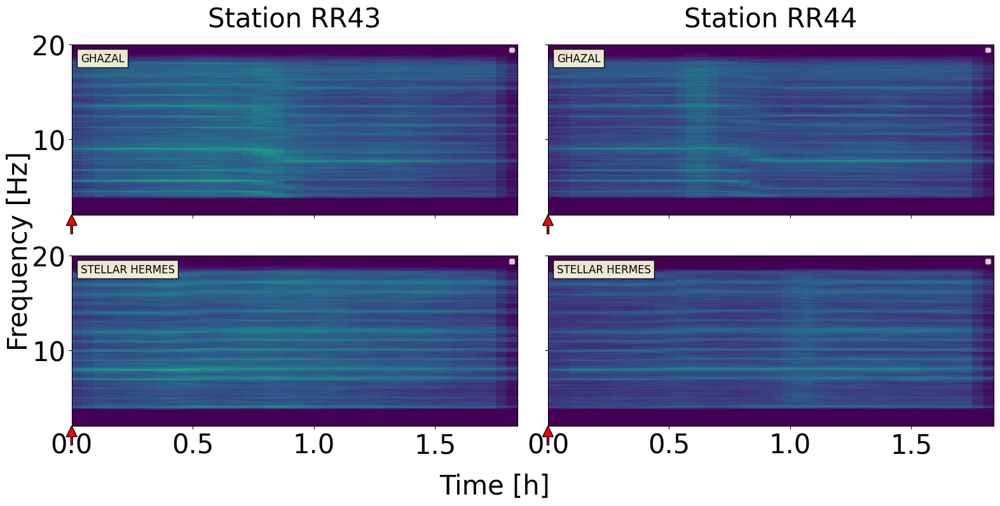

In [ ]:
# Plot one cross-correlation for each ship corresponding to the minimum time delay
min_tau = {}
for mmsi in mmsi_selected:
    tau_mmsi = list(time_delay[mmsi].values())[0]
    min_tau[mmsi] = {}
    min_tau[mmsi]["idx"] = np.argmin(np.abs(tau_mmsi))
    min_tau[mmsi]["tau"] = tau_mmsi[min_tau[mmsi]["idx"]]

    time_min_tau = df_select[df_select["mmsi"] == mmsi]["time"].values[min_tau[mmsi]["idx"]]
    print(f"Time corresponding to minimum tau for ship {mmsi}: {time_min_tau}")
    # Convert time min tau to second from begining
    delta_from_start_min_tau = (
        (df_select[df_select["mmsi"] == mmsi]["time"].values[0] - time_min_tau)
        .astype("timedelta64[s]")
        .astype(float)
    )

    idx_tt = np.argmin(np.abs(tt - delta_from_start_min_tau))
    # Derive corresponding time bin in crosscorr_data
    min_tau[mmsi]["idx_tt"] = idx_tt
    min_tau[mmsi]["tt"] = delta_from_start_min_tau

fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# Reshape ax if only one couple
if n_couple == 1:
    ax = np.array([ax])

for j, mmsi in enumerate(mmsi_selected):
    df_mmsi = df_select[df_select["mmsi"] == mmsi]
    ship_name = df_mmsi["shipName"].values[0]
    ax[0, j].set_title(f"{ship_name}")
    for i, rcv_couple in enumerate(crosscorr_data[mmsi].keys()):
        lags = crosscorr_data[mmsi][rcv_couple]["lags"]
        ax[i, j].plot(
            lags,
            crosscorr_data[mmsi][rcv_couple]["c_xy"][min_tau[mmsi]["idx_tt"], :],
            # label=f"Ship {mmsi}",
        )

        ax[i, j].text(
            0.015,
            0.85,
            rcv_couple,
            transform=ax[i, j].transAxes,
            ha="left",
            fontsize=10,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )

        ax[i, j].axvline(
            time_delay[mmsi][rcv_couple][min_tau[mmsi]["idx"]],
            color="r",
            linestyle="--",
            label="Theoretical time delay",
        )

        # Set xlims 
        ax[i, j].set_xlim(-600, 600)

    ax[0, j].legend(loc="upper right", fontsize=12)

fig.supxlabel("Lags [s]")
fig.supylabel(r"$C_{xy}$")

# Plot spectrograms
vmin = -100
vmax = 0

fig, ax = plt.subplots(n_ships, n_stations, sharex=True, sharey=True)
for i, s_id in enumerate(station_id):
    for j, mmsi in enumerate(mmsi_selected):
        stft = stft_data_crosscorr[mmsi][s_id]["stft"]
        f = stft_data_crosscorr[mmsi][s_id]["f"]
        tt = stft_data_crosscorr[mmsi][s_id]["tt"]

        ship_name = df_select[df_select["mmsi"] == mmsi]["shipName"].values[0]

        tt_hour = tt / 3600
        ax[j, i].pcolormesh(
            tt_hour,
            f,
            20 * np.log10(np.abs(stft)),
            shading="gouraud",
            vmin=vmin,
            vmax=vmax,
        )

        # ax[j, 0].set_ylabel("Frequency [Hz]")
        ax[j, i].text(
            0.02,
            0.9,
            ship_name,
            transform=ax[j, i].transAxes,
            ha="left",
            fontsize=12,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )
        ax[j, i].legend(loc="upper right", fontsize=7)

        # Add arrow pointing the center of the cross-corr window
        ax[j, i].annotate(
            "",
            xy=(tt_hour[min_tau[mmsi]["idx_tt"]], 2),
            xytext=(tt_hour[min_tau[mmsi]["idx_tt"]], 0),
            arrowprops=dict(facecolor="red", width=2),
            ha="center",
        )
        

    ax[0, i].set_title(f"Station {station_id[i]}")
    # ax[-1, i].set_xlabel("Time [h]")

fig.supxlabel("Time [h]")
fig.supylabel("Frequency [Hz]")
plt.ylim([fmin - 2, fmax + 2])
plt.tight_layout()

Time corresponding to maximum tau for ship 403508000: 2013-05-28T03:45:17.000000000
Time corresponding to maximum tau for ship 353766000: 2013-05-07T09:08:35.000000000


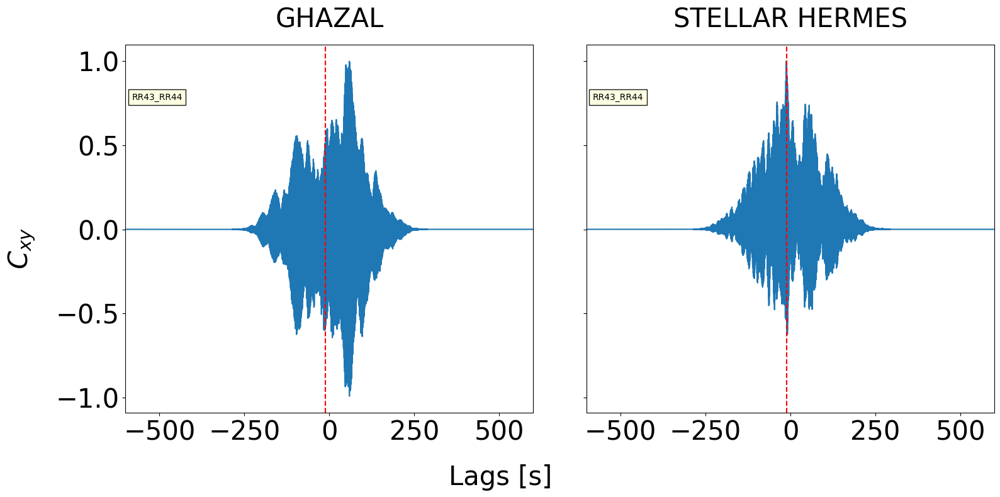

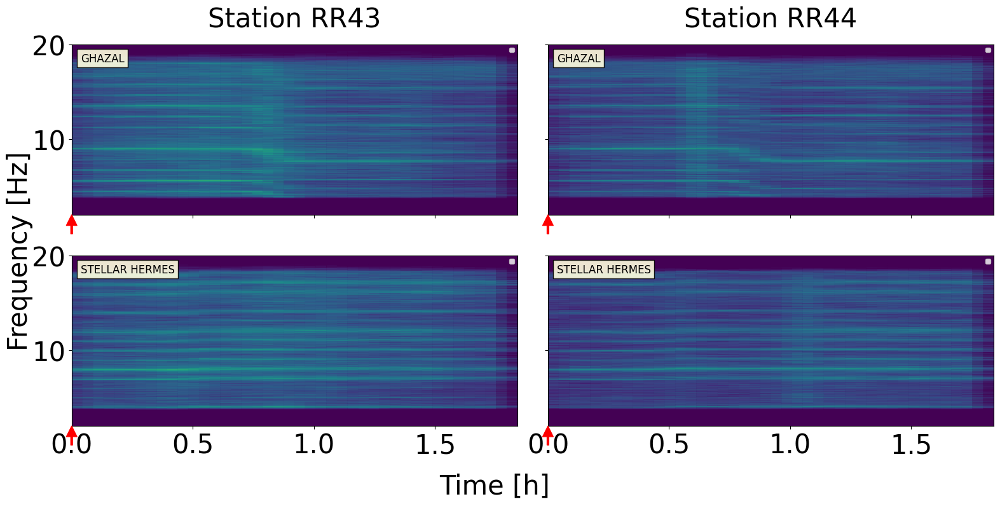

In [ ]:
# Plot one cross-correlation for each ship corresponding to the maximum time delay
max_tau = {}
for mmsi in mmsi_selected:
    tau_mmsi = list(time_delay[mmsi].values())[0]
    max_tau[mmsi] = {}
    max_tau[mmsi]["idx"] = np.argmax(np.abs(tau_mmsi))
    max_tau[mmsi]["tau"] = tau_mmsi[max_tau[mmsi]["idx"]]

    time_max_tau = df_select[df_select["mmsi"] == mmsi]["time"].values[
        max_tau[mmsi]["idx"]
    ]
    print(f"Time corresponding to maximum tau for ship {mmsi}: {time_max_tau}")
    # Convert time min tau to second from begining
    delta_from_start_max_tau = (
        (df_select[df_select["mmsi"] == mmsi]["time"].values[0] - time_max_tau)
        .astype("timedelta64[s]")
        .astype(float)
    )

    idx_tt = np.argmin(np.abs(tt - delta_from_start_max_tau))
    # Derive corresponding time bin in crosscorr_data
    max_tau[mmsi]["idx_tt"] = idx_tt
    max_tau[mmsi]["tt"] = delta_from_start_max_tau

fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# Reshape ax if only one couple
if n_couple == 1:
    ax = np.array([ax])

for j, mmsi in enumerate(mmsi_selected):
    df_mmsi = df_select[df_select["mmsi"] == mmsi]
    ship_name = df_mmsi["shipName"].values[0]
    ax[0, j].set_title(f"{ship_name}")
    for i, rcv_couple in enumerate(crosscorr_data[mmsi].keys()):
        lags = crosscorr_data[mmsi][rcv_couple]["lags"]
        ax[i, j].plot(
            lags,
            crosscorr_data[mmsi][rcv_couple]["c_xy"][max_tau[mmsi]["idx_tt"], :],
            label=f"Ship {mmsi}",
        )
        ax[i, j].text(
            0.015,
            0.85,
            rcv_couple,
            transform=ax[i, j].transAxes,
            ha="left",
            fontsize=10,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )

        ax[i, j].axvline(
            time_delay[mmsi][rcv_couple][max_tau[mmsi]["idx"]],
            color="r",
            linestyle="--",
            label="Theoretical time delay",
        )

        # Set xlims
        ax[i, j].set_xlim(-600, 600)
        
        # ax[j].set_xlabel("Lags [s]")
# ax[0].set_ylabel(r"$C_{xy}$")

fig.supxlabel("Lags [s]")
fig.supylabel(r"$C_{xy}$")


# Plot corresponding time window over spectrogram for each ship and each receiver
# Plot spectrograms
vmin = -100
vmax = 0

fig, ax = plt.subplots(n_ships, n_stations, sharex=True, sharey=True)
for i, s_id in enumerate(station_id):
    for j, mmsi in enumerate(mmsi_selected):
        stft = stft_data_crosscorr[mmsi][s_id]["stft"]
        f = stft_data_crosscorr[mmsi][s_id]["f"]
        tt = stft_data_crosscorr[mmsi][s_id]["tt"]

        ship_name = df_select[df_select["mmsi"] == mmsi]["shipName"].values[0]

        tt_hour = tt / 3600
        ax[j, i].pcolormesh(
            tt_hour,
            f,
            20 * np.log10(np.abs(stft)),
            shading="gouraud",
            vmin=vmin,
            vmax=vmax,
        )

        # ax[j, 0].set_ylabel("Frequency [Hz]")
        ax[j, i].text(
            0.02,
            0.9,
            ship_name,
            transform=ax[j, i].transAxes,
            ha="left",
            fontsize=12,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )
        ax[j, i].legend(loc="upper right", fontsize=7)

        # Add arrow pointing the center of the cross-corr window
        ax[j, i].annotate(
            "",
            xy=(tt_hour[max_tau[mmsi]["idx_tt"]], 2),
            xytext=(tt_hour[max_tau[mmsi]["idx_tt"]], 0),
            arrowprops=dict(facecolor="red", edgecolor="red", width=2),
            ha="center",
        )

    ax[0, i].set_title(f"Station {station_id[i]}")
    # ax[-1, i].set_xlabel("Time [h]")

fig.supxlabel("Time [h]")
fig.supylabel("Frequency [Hz]")
plt.ylim([fmin - 2, fmax + 2])
plt.tight_layout()

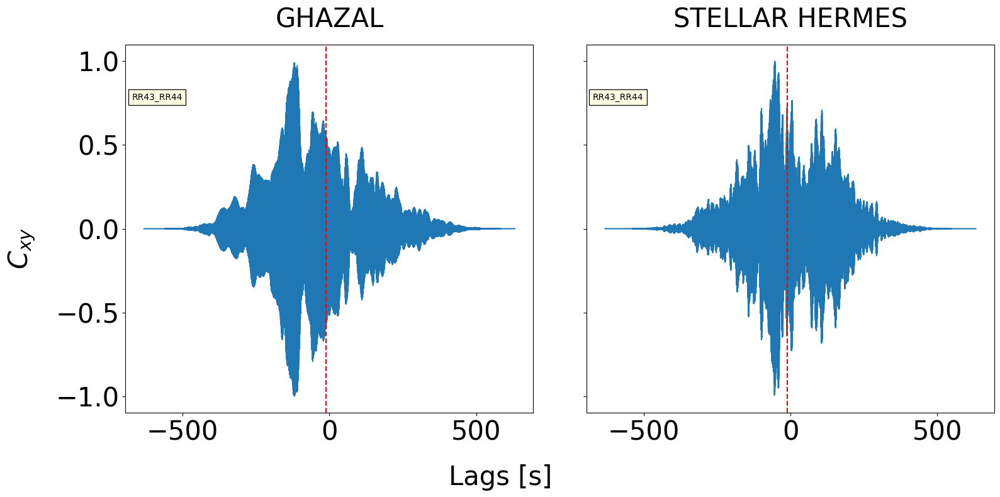

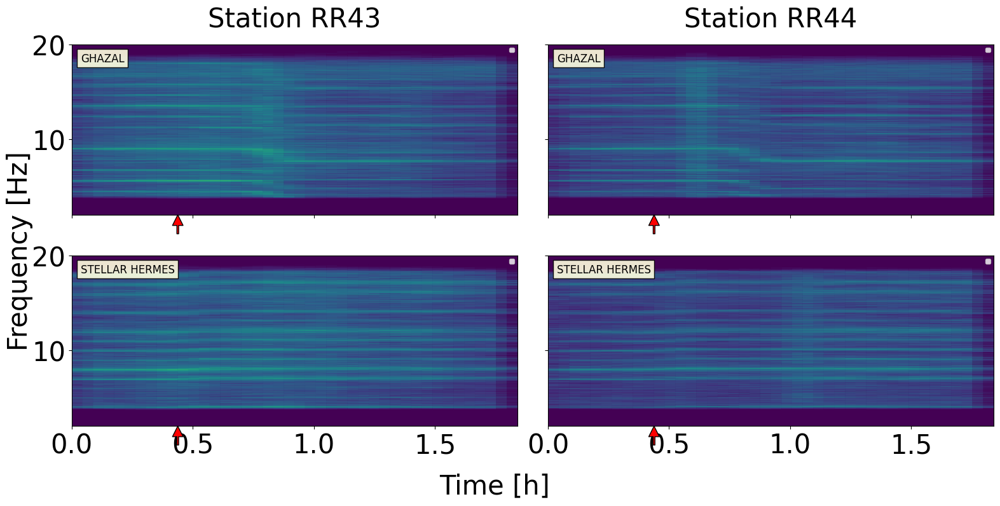

In [ ]:
# Plot one cross-correlation for each ship corresponding to a given time along the trajectory
idx_time_trajectory = np.random.randint(0, len(tt))

fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# Reshape ax if only one couple
if n_couple == 1:
    ax = np.array([ax])

for j, mmsi in enumerate(mmsi_selected):
    df_mmsi = df_select[df_select["mmsi"] == mmsi]
    ship_name = df_mmsi["shipName"].values[0]
    ax[0, j].set_title(f"{ship_name}")
    for i, rcv_couple in enumerate(crosscorr_data[mmsi].keys()):
        lags = crosscorr_data[mmsi][rcv_couple]["lags"]
        ax[i, j].plot(
            lags,
            crosscorr_data[mmsi][rcv_couple]["c_xy"][idx_time_trajectory, :],
            label=f"Ship {mmsi}",
        )
        ax[i, j].axvline(
            max_tau[mmsi]["tau"],
            color="r",
            linestyle="--",
            label="Theoretical time delay",
        )
        ax[i, j].text(
            0.015,
            0.85,
            rcv_couple,
            transform=ax[i, j].transAxes,
            ha="left",
            fontsize=10,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )

        # ax[j].set_xlabel("Lags [s]")
# ax[0].set_ylabel(r"$C_{xy}$")

fig.supxlabel("Lags [s]")
fig.supylabel(r"$C_{xy}$")

# Plot corresponding time window over spectrogram for each ship and each receiver
# Plot spectrograms
vmin = -100
vmax = 0

fig, ax = plt.subplots(n_ships, n_stations, sharex=True, sharey=True)

for i, s_id in enumerate(station_id):
    for j, mmsi in enumerate(mmsi_selected):
        stft = stft_data_crosscorr[mmsi][s_id]["stft"]
        f = stft_data_crosscorr[mmsi][s_id]["f"]
        tt = stft_data_crosscorr[mmsi][s_id]["tt"]

        ship_name = df_select[df_select["mmsi"] == mmsi]["shipName"].values[0]

        tt_hour = tt / 3600
        ax[j, i].pcolormesh(
            tt_hour,
            f,
            20 * np.log10(np.abs(stft)),
            shading="gouraud",
            vmin=vmin,
            vmax=vmax,
        )

        # ax[j, 0].set_ylabel("Frequency [Hz]")
        ax[j, i].text(
            0.02,
            0.9,
            ship_name,
            transform=ax[j, i].transAxes,
            ha="left",
            fontsize=12,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )
        ax[j, i].legend(loc="upper right", fontsize=7)

        # Add arrow pointing the center of the cross-corr window
        ax[j, i].annotate(
            "",
            xy=(tt_hour[idx_time_trajectory], 2),
            xytext=(tt_hour[idx_time_trajectory], 0),
            arrowprops=dict(facecolor="red", edgecolor="k", width=2),
            ha="center",
        )

    ax[0, i].set_title(f"Station {station_id[i]}")
    # ax[-1, i].set_xlabel("Time [h]")

fig.supxlabel("Time [h]")
fig.supylabel("Frequency [Hz]")
plt.ylim([fmin - 2, fmax + 2])
plt.tight_layout()

In [ ]:
# Derive double correlation function 
dcf = {}

# Iterate over receiver couples 
for i, rcv_couple in enumerate(crosscorr_data[mmsi].keys()):

    # Cross corr for ship 1
    mmsi1 = mmsi_selected[0]
    c_xy1 = crosscorr_data[mmsi1][rcv_couple]["c_xy"]
    lags1 = crosscorr_data[mmsi1][rcv_couple]["lags"]

    # Cross corr for ship 2
    mmsi2 = mmsi_selected[1]
    c_xy2 = crosscorr_data[mmsi2][rcv_couple]["c_xy"]
    
    # Derive double correlation function
    dcf[rcv_couple] = np.sum(c_xy1 * c_xy2, axis=1)


ValueError: operands could not be broadcast together with shapes (22,126175) (22,126171) 

In [ ]:
# Derive coherence over time using Welch method
n_period_per_sub_segment = 15
fray_min = 4
max_signal_period = 1 / fray_min
nperseg_sub = int(max_signal_period * n_period_per_sub_segment * fs)
noverlap_sub = int(nperseg_sub * 2 / 3)


coh_perio = {}
for mmsi in mmsi_selected:
    coh_perio[mmsi] = {}
    for i, rcv_id1 in enumerate(rcv_info["id"]):
        for j, rcv_id2 in enumerate(rcv_info["id"]):
            if i < j:
                rcv_couple_id = f"{rcv_id1}_{rcv_id2}"

                s1 = loaded_data[rcv_id1][mmsi]
                s2 = loaded_data[rcv_id2][mmsi]
                fs = s1["sig"].meta.sampling_rate

                nperseg = np.floor(Tcorr[mmsi] * fs).astype(int)    # Window length
                noverlap = int(nperseg * 2 / 3) 

                frequencies, time, coherence_matrix = compute_coherence_spectrogram(
                    s1["data"], s2["data"], fs, nperseg, noverlap, nperseg_sub, noverlap_sub
                )

                coh_perio[mmsi][rcv_couple_id] = {}
                coh_perio[mmsi][rcv_couple_id]["tt"] = time
                coh_perio[mmsi][rcv_couple_id]["f"] = frequencies
                coh_perio[mmsi][rcv_couple_id]["coh"] = coherence_matrix

Text(0.02, 0.5, 'Frequency [Hz]')

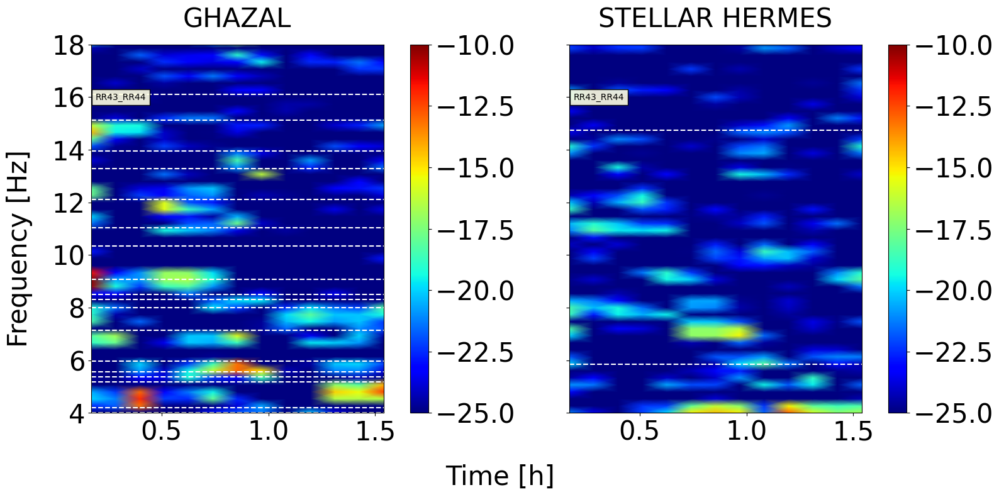

In [ ]:
# Plot coherence spectrogram
n_couple = len(coh_perio[mmsi].keys())
n_ships = len(mmsi_selected)
fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# Reshape ax if only one couple
if n_couple == 1:
    ax = np.array([ax])


for j, mmsi in enumerate(mmsi_selected):
    df_mmsi = df_select[df_select["mmsi"] == mmsi]
    ship_name = df_mmsi["shipName"].values[0]
    ax[0, j].set_title(f"{ship_name}")
    for i, rcv_couple in enumerate(coh_perio[mmsi].keys()):
        tt = coh_perio[mmsi][rcv_couple]["tt"]
        tt_hour = tt / 3600
        f = coh_perio[mmsi][rcv_couple]["f"]
        coh = coh_perio[mmsi][rcv_couple]["coh"]
        im = ax[i, j].pcolormesh(
            tt_hour, f, 10*np.log10(coh), shading="gouraud", cmap="jet", vmin=-25, vmax=-10
        )

        ax[i, j].text(
            0.015,
            0.85,
            rcv_couple,
            transform=ax[i, j].transAxes,
            ha="left",
            fontsize=10,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )

        ax[i, j].set_ylim(fmin, fmax)

        # Overlay the cross spectrum with different x-axis
        # f = sxy[mmsi][rcv_couple]["f"]
        # Sxy = sxy[mmsi][rcv_couple]["Sxy"]

        # ax2 = ax[i, j].twiny()
        # # shift = 1 - np.max(10*np.log10(np.abs(Sxy)))
        # ax2.plot(10*np.log10(np.abs(Sxy)), f, color="white", linestyle="--", linewidth=2)
        # ax2.set_ylim(fmin, fmax)
        # ax2.set_xlim(-80, 10)
        # ax2.set_xticklabels([])

        # Add colorbar
        cbar = fig.colorbar(im, ax=ax[i, j])

        # Add detected frequencies as dotted lines
        f_detected_couple = f_detected[mmsi][rcv_couple]["f"]
        for f_d in f_detected_couple:
            ax[i, j].axhline(f_d, color="w", linestyle="--",)

fig.supxlabel("Time [h]")
fig.supylabel("Frequency [Hz]")

## Study coherence
Try to study TDOA using coherence. To do so : 
- Select one ship 
- Select a portion of the signal excluding the CPA (either before or after CPA)
- Derive coherence for this portion of signal 
- Derive coherence for the same portion of signal by shifting the signal from the second receiver by the TDOA 
- Derive coherence for a set of shifting time 


### Select signal portion

In [ ]:
# Select one of the ship to analyze
mmsi = mmsi_selected[0]
ais_mmsi = df_select[df_select["mmsi"] == mmsi]
wav_mmsi = {
    rcv_k: {mmsi: loaded_data[rcv_k][mmsi].copy()} for rcv_k in loaded_data.keys()
}

# fig, ax = plot_spectrograms(wav_data=wav_mmsi, ais_data=ais_mmsi)

wav_data = wav_mmsi
ais_data = ais_mmsi
delta_f = 2
rcv_0 = list(wav_data.keys())[0]
available_mmsi = list(wav_data[rcv_0].keys())
available_stations = list(wav_data.keys())

In [ ]:
idx_time_trajectory_start = 10
idx_time_trajectory_end = 500

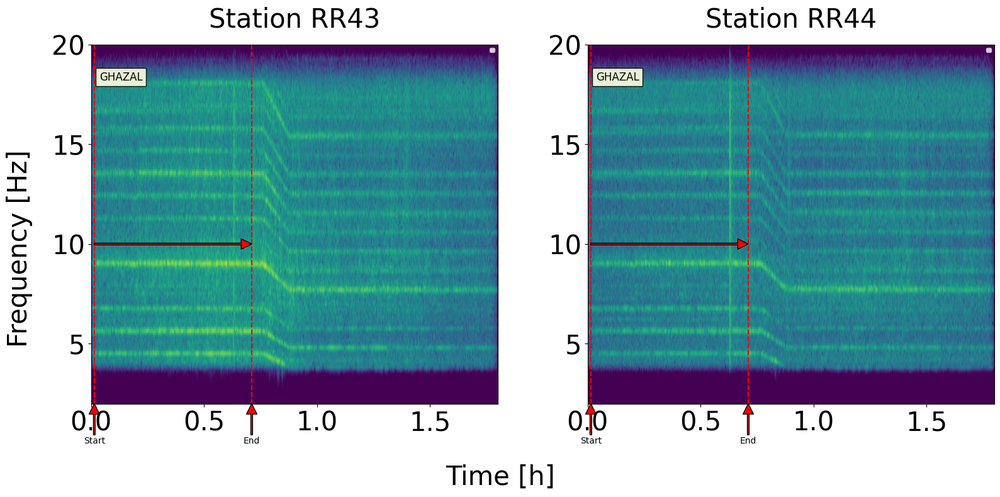

In [ ]:
# %matplotlib inline
vmin = -100
vmax = 0
fig, ax = plt.subplots(len(available_mmsi), len(available_stations), sharex=True)

# Reshape if only one ship
if len(available_mmsi) == 1:
    ax = np.array([ax])

for i, rcv_id in enumerate(available_stations):
    for j, mmsi in enumerate(available_mmsi):
        stft = wav_data[rcv_id][mmsi]["stft"]
        f = wav_data[rcv_id][mmsi]["f"]
        tt = wav_data[rcv_id][mmsi]["tt"]
        ship_name = ais_data[ais_data["mmsi"] == mmsi]["shipName"].values[0]

        tt_hour = tt / 3600
        # ax[j, i].pcolormesh(tt, f, 20*np.log10(np.abs(stft)), shading="gouraud", vmin=vmin, vmax=vmax)
        ax[j, i].pcolormesh(
            tt_hour,
            f,
            20 * np.log10(np.abs(stft)),
            shading="gouraud",
            vmin=vmin,
            vmax=vmax,
        )


        # ax[j, 0].set_ylabel("Frequency [Hz]")
        ax[j, i].text(
            0.02,
            0.9,
            ship_name,
            transform=ax[j, i].transAxes,
            ha="left",
            fontsize=12,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )
        # ax[j, i].set_title(f"{ship_name}")
        ax[j, i].legend(loc="upper right", fontsize=7)
        ax[j, i].set_ylim([fmin - delta_f, fmax + delta_f])

    # ax[-1, i].set_xlabel("Time [s]")
    ax[0, i].set_title(f"Station {rcv_id}")
    # ax[-1, i].set_xlabel("Time [h]")

fig.supxlabel("Time [h]")
fig.supylabel("Frequency [Hz]")

# ax = plt.gca()
# Add arrow pointing the begining of the selected signal portion
for i, rcv_id in enumerate(loaded_data.keys()):

    # Add arrow pointing the beginning of the selected window
    tt = wav_mmsi[rcv_id][mmsi]["tt"]
    tt_hour = tt / 3600
    ax[0, i].annotate(
        "Start",
        xy=(tt_hour[idx_time_trajectory_start], 2),
        xytext=(tt_hour[idx_time_trajectory_start], 0),
        arrowprops=dict(facecolor="red", edgecolor="k", width=2),
        ha="center",
    )
    # Add vertical dotted line
    ax[0, i].axvline(
        tt_hour[idx_time_trajectory_start],
        color="r",
        linestyle="--",
    )

    # Add arrow pointing the end of the selected window
    ax[0, i].annotate(
        "End",
        xy=(tt_hour[idx_time_trajectory_end], 2),
        xytext=(tt_hour[idx_time_trajectory_end], 0),
        arrowprops=dict(facecolor="red", edgecolor="k", width=2),
        ha="center",
    )
    # Add vertical dotted line
    ax[0, i].axvline(
        tt_hour[idx_time_trajectory_end],
        color="r",
        linestyle="--",
    )

    # Draw horizontal arrow from the middlde of the previous dotted line to the end of the recording
    ax[0, i].annotate(
        "",
        xy=(tt_hour[idx_time_trajectory_end], 10),
        xytext=(tt_hour[idx_time_trajectory_start], 10),
        arrowprops=dict(facecolor="red", edgecolor="k", width=2),
        ha="center",
    )

    ax[0, i].set_title(f"Station {rcv_id}")

In [ ]:
# Convert idx_time_traj into idx relative to the data vector 
tt_start = wav_mmsi[rcv_id][mmsi]["tt"][idx_time_trajectory_start]
tt_end = wav_mmsi[rcv_id][mmsi]["tt"][idx_time_trajectory_end]

# Limit data to the selected time window
for i, rcv_id in enumerate(loaded_data.keys()):
    time = wav_mmsi[rcv_id][mmsi]["sig"].times()
    idx_of_interest = (time >= tt_start) & (time <= tt_end)
    wav_mmsi[rcv_id][mmsi]["data"] = wav_mmsi[rcv_id][mmsi]["data"][
        idx_of_interest
    ]
    # wav_mmsi[rcv_id][mmsi]["tt"] = wav_mmsi[rcv_id][mmsi]["tt"][
    #     idx_time_trajectory_start:idx_time_trajectory_end
    # ]
    # wav_mmsi[rcv_id][mmsi]["stft"] = wav_mmsi[rcv_id][mmsi]["stft"][
    #     idx_time_trajectory_start:idx_time_trajectory_end
    # ]

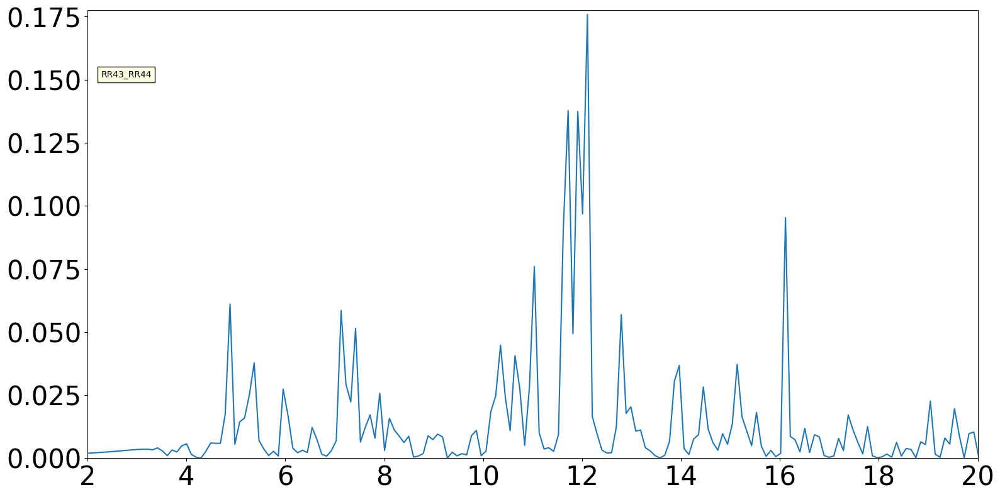

In [ ]:
# Derive coherence without lag
coh_no_lag, sxx, syy, sxy = compute_dsps(wav_mmsi, rcv_info)

# Plot this coherence
n_couple = len(coh_no_lag[mmsi].keys())
n_ships = len(coh_no_lag.keys())
fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# Reshape ax if only one couple
if n_couple == 1:
    ax = np.array([ax])
if n_ships == 1:
    ax = np.array([ax])

for j, mmsi_j in enumerate(coh_no_lag.keys()):
    for i, rcv_couple in enumerate(coh_no_lag[mmsi_j].keys()):
        coh_xy = coh_no_lag[mmsi_j][rcv_couple]["coh_xy"]
        f = coh_no_lag[mmsi_j][rcv_couple]["f"]
        ax[i, j].plot(f, coh_xy, label=f"{rcv_couple}")
        ax[i, j].set_xlim(fmin-2, fmax+2)

        idx_f_in_band = (f >= fmin) & (f <= fmax)
        max_coh = np.max(coh_xy[idx_f_in_band])
        ax[i, j].set_ylim(0, max_coh*1.01)

        # Add text with the name of the receiver couple
        ax[i, j].text(
            0.015,
            0.85,
            rcv_couple,
            transform=ax[i, j].transAxes,
            ha="left",
            fontsize=10,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )

In [ ]:
# Derive coherence with the shift corresponding to the theoretical time delay between the two receivers
idx_mmsi = np.argmin(np.abs(np.array([mmsi_selected[i] - mmsi for i in range(len(mmsi_selected))])))

rcv_id1 = list(loaded_data.keys())[0]
rcv_id2 = list(loaded_data.keys())[1]
# Select the time delay corresponding to the middle of the selected signal portion
tt_middle_portion = wav_mmsi[rcv_id1][mmsi]["tt"][len(wav_mmsi[rcv_id1][mmsi]["tt"]) // 2]
# Convert to datetime using start time of the recording
dt_middle_portion = start_times[idx_mmsi] + pd.Timedelta(seconds=tt_middle_portion)
# Find the closest time in the AIS data
idx_closest = np.argmin(np.abs(ais_data["time"] - dt_middle_portion))
# Select the time delay corresponding to the closest time
th_delay = time_delay[mmsi][rcv_couple][idx_closest]
# Convert to index shift
idx_shift = int(th_delay * fs)


print(f"Time delay : {th_delay} s")
print(f"Index shift : {idx_shift}")

if idx_shift > 0:
    idx_rcv_to_shift = 0
else:
    idx_rcv_to_shift = 1
    idx_shift = -idx_shift

# Shift the second time series by idx_shift 
for i, rcv_id in enumerate(loaded_data.keys()):
    if i == idx_rcv_to_shift:
        # Do not shift the first time serie but remove the last points to keep sizes equal 
        wav_mmsi[rcv_id][mmsi]["data"] = wav_mmsi[rcv_id][mmsi]["data"][:-idx_shift]
        # wav_mmsi[rcv_id][mmsi]["tt"] = wav_mmsi[rcv_id][mmsi]["tt"][:-idx_shift]
        # wav_mmsi[rcv_id][mmsi]["stft"] = wav_mmsi[rcv_id][mmsi]["stft"][:-idx_shift]
    else:
        # Shift the second time serie and remove first points to keep sizes equal
        wav_mmsi[rcv_id][mmsi]["data"] = wav_mmsi[rcv_id][mmsi]["data"][idx_shift:]
        # wav_mmsi[rcv_id][mmsi]["tt"] = wav_mmsi[rcv_id][mmsi]["tt"][idx_shift:]
        # wav_mmsi[rcv_id][mmsi]["stft"] = wav_mmsi[rcv_id][mmsi]["stft"][idx_shift:]


Time delay : -2.073891175015249 s
Index shift : -207


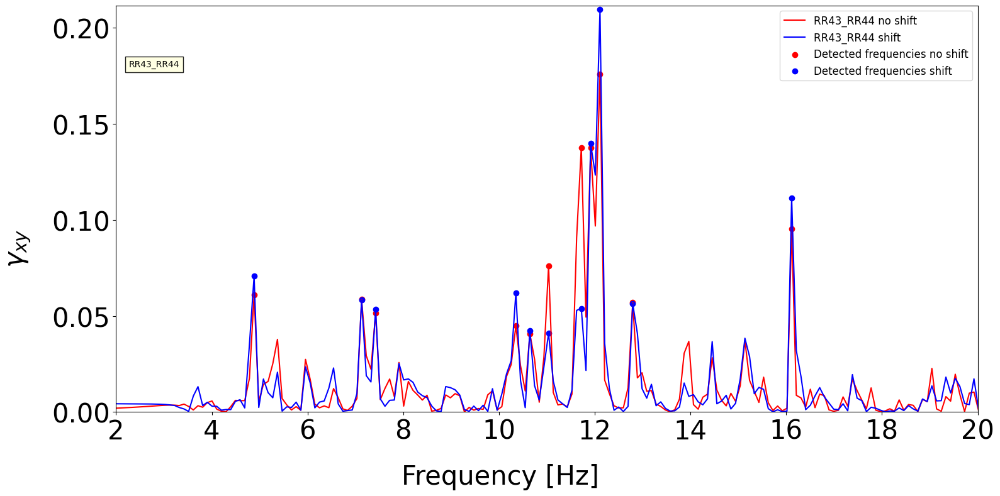

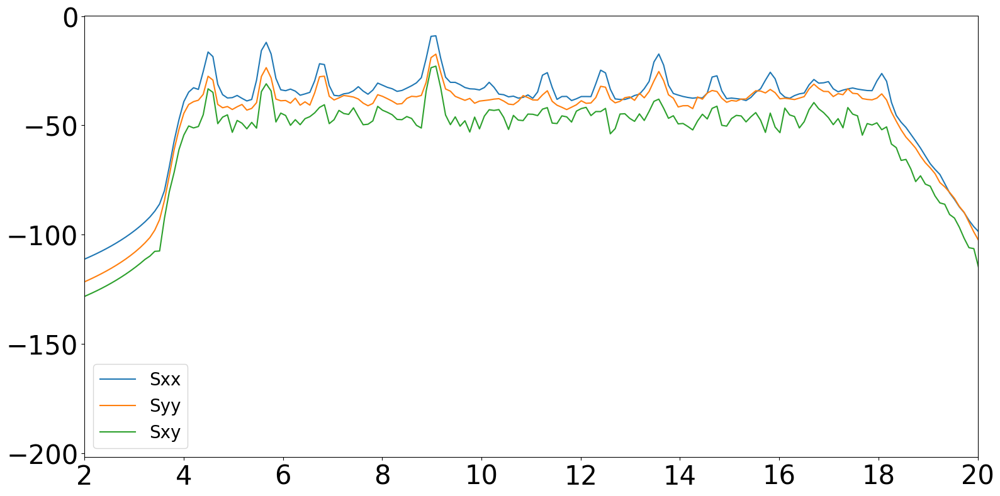

In [ ]:
# Compute coherence with the shifted signal
coh_shifted, sxx, syy, sxy = compute_dsps(wav_mmsi, rcv_info)

# # Plot this coherence
# n_couple = len(coh_shifted[mmsi].keys())
# n_ships = len(coh_shifted.keys())
# fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# # Reshape ax if only one couple
# if n_couple == 1:
#     ax = np.array([ax])
# if n_ships == 1:
#     ax = np.array([ax])

# for j, mmsi_j in enumerate(coh_shifted.keys()):
#     for i, rcv_couple in enumerate(coh_shifted[mmsi_j].keys()):
#         coh_xy = coh_shifted[mmsi_j][rcv_couple]["coh_xy"]
#         f = coh_shifted[mmsi_j][rcv_couple]["f"]
#         ax[i, j].plot(f, coh_xy, label=f"{rcv_couple}")
#         ax[i, j].set_xlim(fmin-2, fmax+2)
#         ax[i, j].set_ylim(0, 0.05)

#         # Add text with the name of the receiver couple
#         ax[i, j].text(
#             0.015,
#             0.85,
#             rcv_couple,
#             transform=ax[i, j].transAxes,
#             ha="left",
#             fontsize=10,
#             bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
#         )

# Detect peak frequencies in coherences 
coh_threshold = 0.04
f_detected_no_lag = {}
f_detected_shifted = {}
for j, rcv_couple in enumerate(coh_no_lag[mmsi].keys()):
    f_detected_no_lag[rcv_couple] = {}
    f_detected_shifted[rcv_couple] = {}
    f_detected_no_lag[rcv_couple]["idx"] = sp.find_peaks(coh_no_lag[mmsi][rcv_couple]["coh_xy"], height=coh_threshold)[0]
    f_detected_shifted[rcv_couple]["idx"] = sp.find_peaks(coh_shifted[mmsi][rcv_couple]["coh_xy"], height=coh_threshold)[0]
    f_detected_no_lag[rcv_couple]["f"] = coh_no_lag[mmsi][rcv_couple]["f"][f_detected_no_lag[rcv_couple]["idx"]]
    f_detected_shifted[rcv_couple]["f"] = coh_shifted[mmsi][rcv_couple]["f"][f_detected_shifted[rcv_couple]["idx"]]


# Plot the coherence with and without shift
fig, ax = plt.subplots(n_couple, n_ships, sharey=True, sharex=True)

# Reshape ax if only one couple
if n_couple == 1:
    ax = np.array([ax])
if n_ships == 1:
    ax = np.array([ax])

for j, mmsi_j in enumerate(coh_no_lag.keys()):
    for i, rcv_couple in enumerate(coh_no_lag[mmsi_j].keys()):
        coh_xy = coh_no_lag[mmsi_j][rcv_couple]["coh_xy"]
        f = coh_no_lag[mmsi_j][rcv_couple]["f"]
        ax[i, j].plot(f, coh_xy, label=f"{rcv_couple} no shift", color="r")
        coh_xy = coh_shifted[mmsi_j][rcv_couple]["coh_xy"]
        f = coh_shifted[mmsi_j][rcv_couple]["f"]
        ax[i, j].plot(f, coh_xy, label=f"{rcv_couple} shift", color="b")
        ax[i, j].set_xlim(fmin-2, fmax+2)

        idx_f_in_band = (f >= fmin) & (f <= fmax)
        max_coh = max(
            np.max(coh_no_lag[mmsi_j][rcv_couple]["coh_xy"][idx_f_in_band]),
            np.max(coh_shifted[mmsi_j][rcv_couple]["coh_xy"][idx_f_in_band]),
        )
        ax[i, j].set_ylim(0, max_coh*1.01)

        # Add text with the name of the receiver couple
        ax[i, j].text(
            0.015,
            0.85,
            rcv_couple,
            transform=ax[i, j].transAxes,
            ha="left",
            fontsize=10,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )

        # Add detected peaks as scatter points 
        f_detected_no_lag_couple = f_detected_no_lag[rcv_couple]["f"]
        f_detected_shifted_couple = f_detected_shifted[rcv_couple]["f"]
        
        ax[i, j].scatter(
            f_detected_no_lag_couple,
            coh_no_lag[mmsi_j][rcv_couple]["coh_xy"][f_detected_no_lag[rcv_couple]["idx"]],
            color="r",
            label="Detected frequencies no shift",
        )
        ax[i, j].scatter(
            f_detected_shifted_couple,
            coh_shifted[mmsi_j][rcv_couple]["coh_xy"][f_detected_shifted[rcv_couple]["idx"]],
            color="b",
            label="Detected frequencies shift",
        )


        ax[i, j].legend(loc="upper right", fontsize=12)
fig.supxlabel("Frequency [Hz]")
fig.supylabel(r"$\gamma_{xy}$")

# Plot dsp 
plt.figure()
plt.plot(sxx[mmsi][rcv_couple]["f"], 10*np.log10(sxx[mmsi][rcv_couple]["Sxx"]), label="Sxx")
plt.plot(syy[mmsi][rcv_couple]["f"], 10*np.log10(syy[mmsi][rcv_couple]["Syy"]), label="Syy")
plt.plot(sxy[mmsi][rcv_couple]["f"], 10*np.log10(np.abs(sxy[mmsi][rcv_couple]["Sxy"])), label="Sxy")
plt.xlim(fmin-2, fmax+2)
plt.legend()

Text(0.02, 0.5, 'Frequency [Hz]')

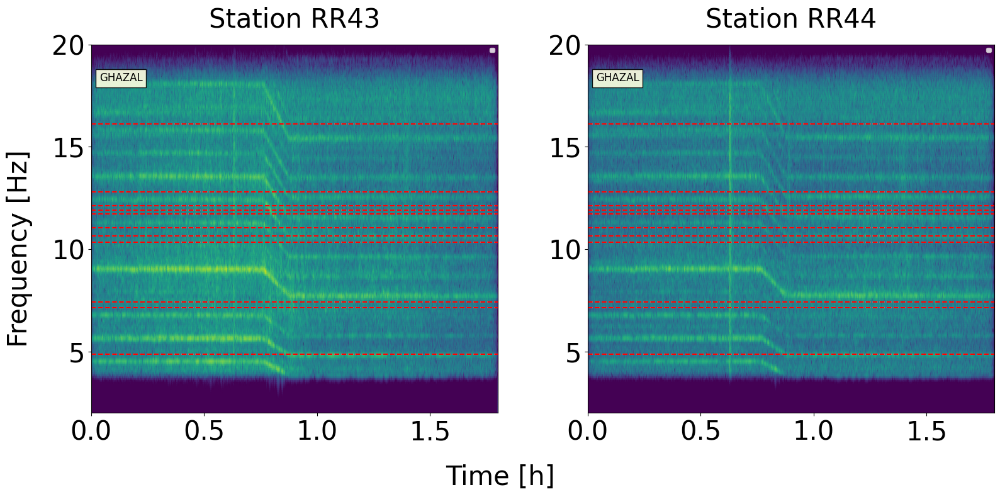

In [ ]:
# Plot spectrograms and detected frequencies

# First : spectrograms and detected frequencies without shift
wav_data = wav_mmsi
ais_data = ais_mmsi
delta_f = 2
rcv_0 = list(wav_data.keys())[0]
available_mmsi = list(wav_data[rcv_0].keys())
available_stations = list(wav_data.keys())

fig, ax = plt.subplots(len(available_mmsi), len(available_stations), sharex=True)

# Reshape if only one ship
if len(available_mmsi) == 1:
    ax = np.array([ax])

for i, rcv_id in enumerate(available_stations):
    for j, mmsi in enumerate(available_mmsi):
        stft = wav_data[rcv_id][mmsi]["stft"]
        f = wav_data[rcv_id][mmsi]["f"]
        tt = wav_data[rcv_id][mmsi]["tt"]
        ship_name = ais_data[ais_data["mmsi"] == mmsi]["shipName"].values[0]

        tt_hour = tt / 3600
        ax[j, i].pcolormesh(
            tt_hour,
            f,
            20 * np.log10(np.abs(stft)),
            shading="gouraud",
            vmin=vmin,
            vmax=vmax,
        )

        ax[j, i].text(
            0.02,
            0.9,
            ship_name,
            transform=ax[j, i].transAxes,
            ha="left",
            fontsize=12,
            bbox=dict(facecolor="lightyellow", edgecolor="black", alpha=0.9),
        )

        # Add detected frequencies as dotted lines
        rcv_couple = list(coh_no_lag[mmsi].keys())[0]
        f_detected_couple = f_detected_no_lag[rcv_couple]["f"]
        f_detected_couple_shift = f_detected_shifted[rcv_couple]["f"]
        for f_d in f_detected_couple:
            ax[j, i].axhline(f_d, color="w", linestyle="--",)
        for f_d in f_detected_couple_shift:
            ax[j, i].axhline(f_d, color="r", linestyle="--",)

        ax[j, i].legend(loc="upper right", fontsize=7)
        ax[j, i].set_ylim([fmin - delta_f, fmax + delta_f])

    ax[0, i].set_title(f"Station {rcv_id}")

fig.supxlabel("Time [h]")
fig.supylabel("Frequency [Hz]")

# Left overs 

In [ ]:
# Derive cross-spectrum 
Sxy = loaded_data["RR41"][mmsi2]["stft"] * np.conj(loaded_data["RR47"][mmsi2]["stft"]) 
# Derive coherence
rho_xy = np.abs(Sxy)**2 / (loaded_data["RR41"][mmsi2]["stft"] * np.conj(loaded_data["RR41"][mmsi2]["stft"]) * loaded_data["RR47"][mmsi2]["stft"] * np.conj(loaded_data["RR47"][mmsi2]["stft"]))
# Derive cross_correlation 
Cxy = sf.irfft(Sxy, axis=0)
Cxy = Cxy / np.max(np.abs(Cxy))

KeyError: 'RR41'

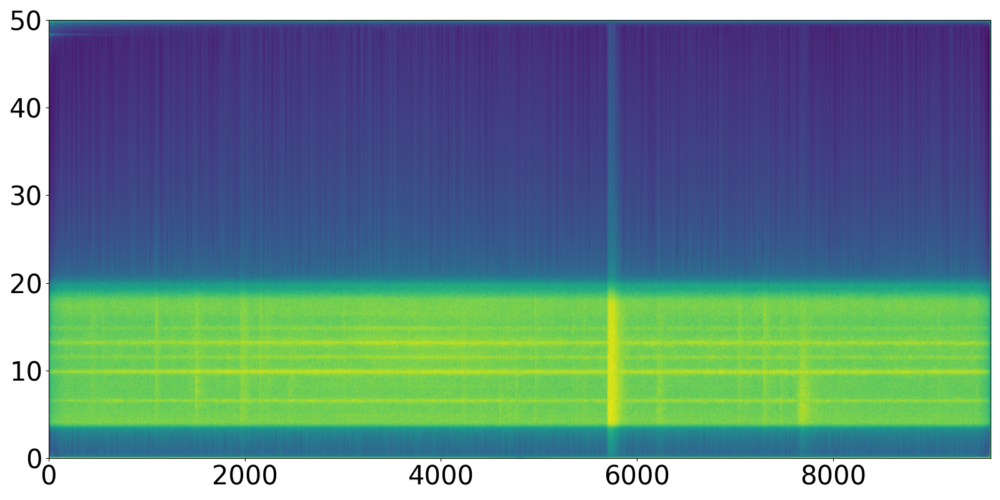

In [ ]:
#Plot cross-spectrum
plt.figure()
plt.pcolormesh(loaded_data["RR41"][mmsi1]["tt"], loaded_data["RR41"][mmsi1]["f"], 20*np.log10(np.abs(Sxy)), shading="gouraud")

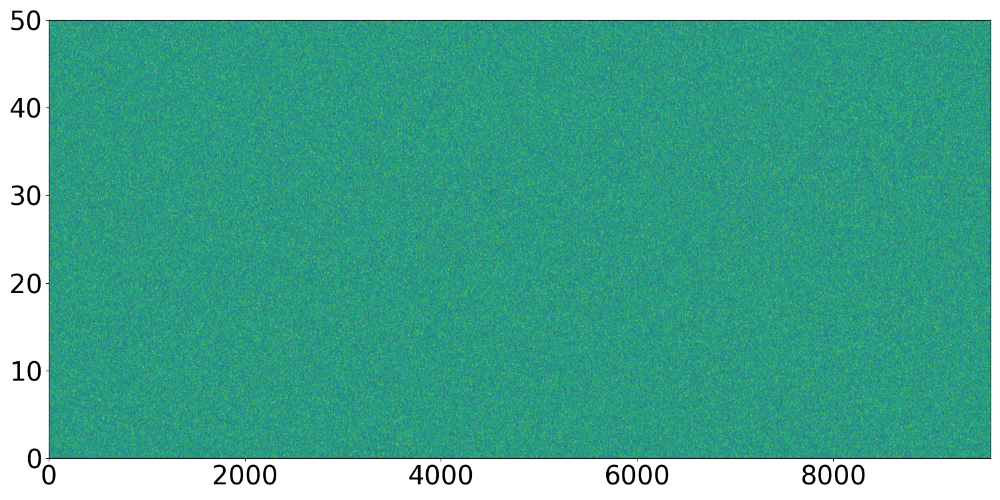

In [ ]:
# Plot coherence
plt.figure()
plt.pcolormesh(loaded_data["RR41"][mmsi1]["tt"], loaded_data["RR41"][mmsi1]["f"], np.abs(rho_xy), shading="gouraud")

Text(0, 0.5, 'Time [s]')

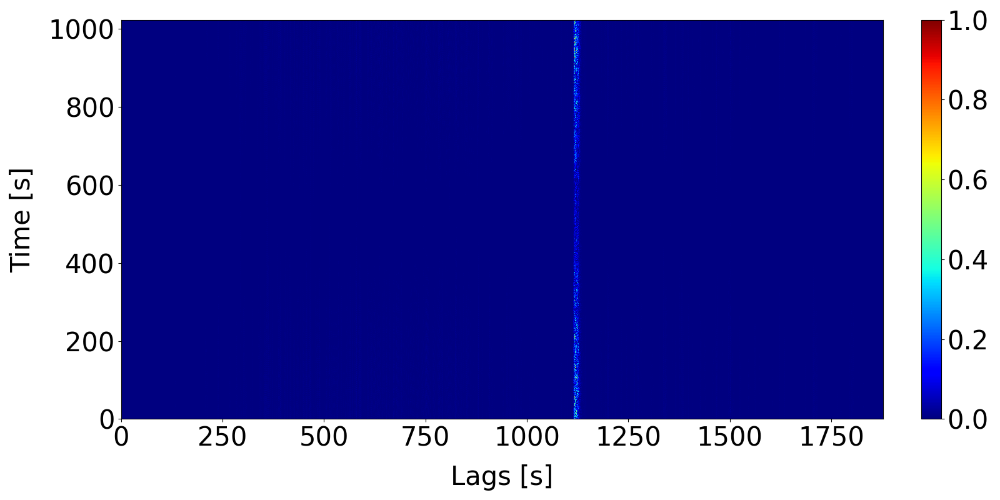

In [ ]:
# Plot cross-correlation
nperseg = 2**10
lags_idx = sp.correlation_lags(nperseg//2, nperseg//2, mode="full")
lags = lags_idx * 1/loaded_data["RR41"][mmsi2]["sig"].meta.sampling_rate

# lags = lags_idx * loaded_data["RR41"][mmsi2]["data"]
plt.figure()
plt.pcolormesh(
    # lags,
    # loaded_data["RR41"][mmsi1]["tt"],
    np.abs(Cxy),
    cmap="jet"
)
plt.colorbar()
plt.xlabel("Lags [s]")
plt.ylabel("Time [s]")

1121


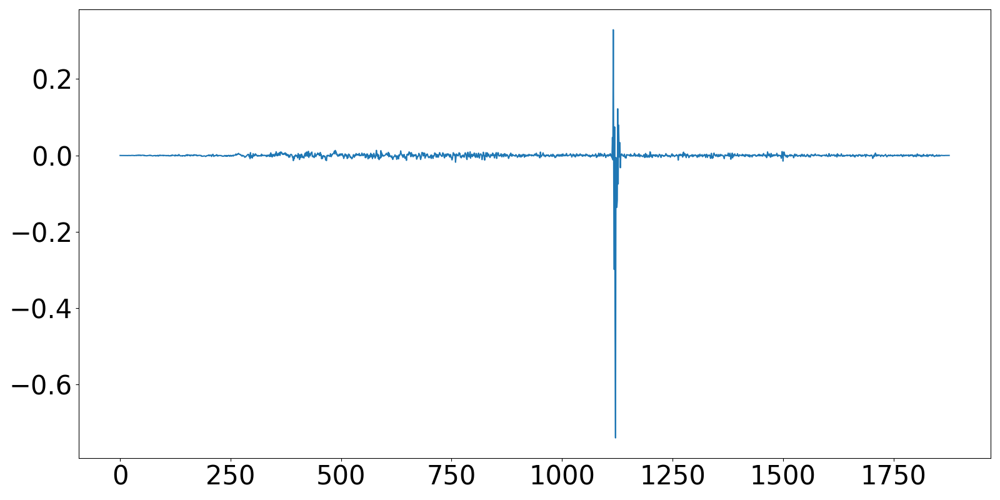

In [ ]:
plt.figure()
plt.plot(Cxy[100, :])

tau = np.argmax(np.abs(Cxy[100, :]))
print(tau)

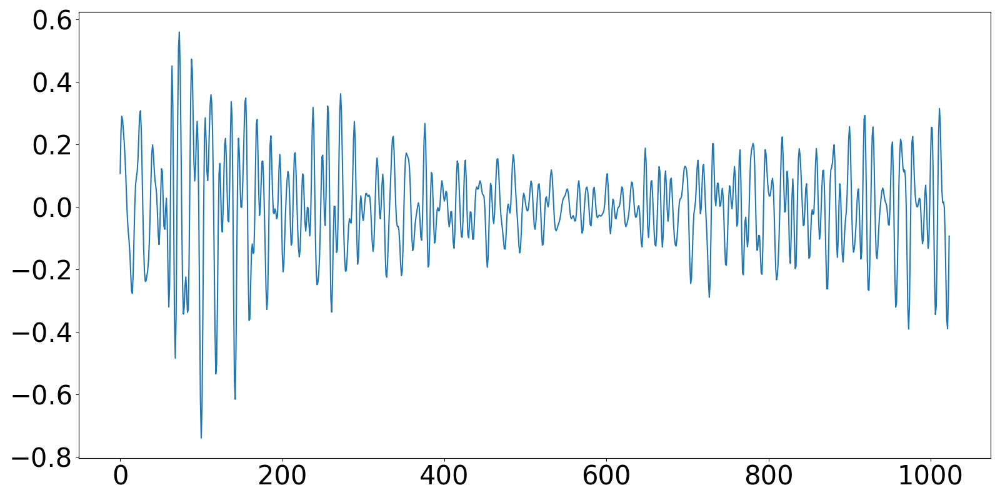

In [ ]:
plt.figure()
plt.plot(Cxy[:, tau])

In [ ]:
# ugly implementation to understand what is happening

# Iterate over the columns of the STFT matrix and compute the cross-correlation
Cxy = np.zeros((loaded_data["RR41"][mmsi1]["stft"].shape[1], nperseg))

for i in range(loaded_data["RR41"][mmsi1]["stft"].shape[1]):
    col_rr41 = loaded_data["RR41"][mmsi1]["stft"][:, i]
    col_rr47 = loaded_data["RR47"][mmsi1]["stft"][:, i]
    Sxy = col_rr41 * np.conj(col_rr47)
    Cxy[i, :] = sf.irfft(Sxy, axis=0)

Cxy = Cxy / np.max(np.abs(Cxy))
